In [1]:
import pandas as pd
import numpy as np
import json
from collections import defaultdict

import networkx as nx
import matplotlib.pyplot as plt
%matplotlib inline

from fa2 import ForceAtlas2
import community

import os
import sys
import copy

import re
import nltk
from nltk.corpus import stopwords
import progressbar

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import community

from PIL import Image
import random

# 1. Motivation

+ **What is your dataset?**

The dataset used in the following analysis is a collection of [Wookieepedia](https://starwars.wikia.com/)[6] articles and movie/TV scripts from the Star Wars universe. Wookieepedia is the unofficial Star Wars wiki and contains articles about everything related to Star Wars. It was the obvious choice to get information about both the movies and the characters that appear in them. From the articles for every movie and every TV-episode the characters that appeared were extracted to build a list of every character that has appeared in the Star Wars universe. Using that character list the Wookieepedia article for each character was downloaded.

For the scripts the webpage [Springfield! Springfield!](https://www.springfieldspringfield.co.uk/)[7] was used. It contains a huge collection of movie and TV scripts/transcripts that are available to download for everyone.

+ **Why did you choose these particular datasets?**

I chose Wookieepedia to get the majority of my data because it is the un-official wiki for everything Star Wars. It has articles about all the movies with a list of characters that appeared in them, and it has articles for each of those characters. It is even so simple that the list of characters in the movies actually links directly to the pages of those characters.

I would have liked to use Wookieepedia for the scripts just like I used it for the rest of the data. The problem was that the scripts on Wookieepedia were not all on the same format and some of them were incomplete. When I figured that out I found the Springfield! Springfield! webpage. It seems to have all the complete scripts for both the movies and each TV-episode. More importantly all of it is on the same format, which makes it easier to use for text analysis.

+ **What was your goal for the end user's experience?**

I wanted to see what the network built using the Wookieepedia data looked like and if there were any surprises to be revealed, f.ex. are the best connected characters those that we expect? 

I also wanted to use text analysis to find out what words characterize the scripts of the movies and see if they can describe the story the movie tells in any way.

With sentiment analysis I wanted to do two things. Firstly, I wanted to make a timeline of the sentiment in the Star Wars galaxy by using each movie and tv episode as a data point. The sentiment from the movies can be calculated from their scripts. Secondly, I wanted to find out who the most happy/unhappy characters are by analysing the sentiment in their Wookieepedia articles and see if the result is something that can be expected.


# 2. Basic Stats

+ **Write about your choices in data cleaning and preprocessing**

When downloaded from their respective pages all the scripts are just plain text, so no cleaning or preprocessing was applied there.

To be able to download all the character pages the names of all the characters that have appeared in each of the movies and TV-series had to be extracted. This is done by downloading the Wookieepedia pages of each movie and each TV-episode. On these pages the characters are all listed in their respective sections that are start with either **c-characters=** or **characters=** and end with **\n\n|** or **l-characters=**. A regular expression is used to extract the links to each character page. The links are on the form **[[link|optional title]]**. The optional title for the links is only regarded in the case the link is *Anakin Skywalker*. This is done since the *Anakin Skywalker* page velong to both Anakin Skywalker and Darth Vader. In this case the optional title is processed to check if the link belongs to Skywalker or Vader.

+ **Write a short section that discusses the dataset stats (here you can recycle the work you did for Project Assignment A)**

When all the data has been downloaded it is stored in a .json file where the pages for each movie is keyed by the name of the movie, the pages for the tv-episodes is keyed by the series name and the episode name, and the pages for the characters are keyed by the name of the characters. This .json files contains the pages of 11 movies, 2 animated TV-series with a total of 195 episodes between them, and the pages for 1945 characters. The file is almost 23 MB.

The scripts are stored in their own .json that is keyed in a similar way as the other .json file. The 11 movies are keyed by their name and the 195 TV-episodes are keyed by the name of the series they belong to and the name of the episode. The .json file for the scripts is almost 2.5 MB.

# 3. Tools, theory and analysis

+ **The overall idea**

For each of the 11 movies and 2 animated TV-series a network[1] will be built that describes how characters are linked together. The nodes in the networks are the characters and a link from one node A to node B means that there exists a link in the Wookieepedia page of character A that point to the Wookieepedia page of character B. What can these networks tell us about the films and TV-series? We can find out what characters have the most connections and take a look at if these are the characters that we expect to see, i.e. the characters that play a central role in the storyline of the movies or TV-series.

For text analysis TF-IDF will be used to generate a measure of how often a word is used across all the scripts. That measure along with all the words will be used to make a Word Cloud for each film and TV-series. Can we in some way relate the words in the Word Clouds to the storyline of the films and TV-series?
The sentiment of the scripts are calculated and used to create a timeline of how the sentiment evolves between movies. Can this timeline be explained in any way with the storyline of each individual movie in mind? For further sentiment analysis the Wookieepedia pages of each character is analyzed to find out how the most positive/negative characters are. Can we explain the results, or is Wookieepedia not a good source to analyze sentiment in the characters?



## Function definitions

In [2]:
# Function to calculate TF-IDF
def TFIDF(dataframes):
    dataframes_tfidf = []
    all_words = []
    
    #Caclulate TF
    for i in range(len(dataframes)):
        df = dataframes[i]
        df_tfidf = df.groupby("word").size()
        df_words = df_tfidf.index
        df_counts = df_tfidf.values
        
        df_tfidf = pd.DataFrame(data=dict(word=df_words, TF=df_counts))
        df_tfidf.sort_values(by="TF", ascending=False)
        df_tfidf.reset_index(inplace=True)
        dataframes_tfidf.append(df_tfidf)
        
        all_words.extend(df_words)
    
    df_all = pd.DataFrame(data=dict(word=all_words))
    df_all = df_all.groupby("word").size()
    df_all_words = df_all.index
    df_all_counts = df_all.values
    df_all = pd.DataFrame(data=dict(word=df_all_words,
                                    count=df_all_counts))
    #Calculate IDF
    N = len(dataframes)
    for i in range(len(dataframes_tfidf)):
        df = dataframes_tfidf[i]
        df_merged = pd.merge(df, df_all, on="word")
        df_merged["IDF"] = N/(1+np.log(df_merged["count"]))
        df_merged["TFIDF"] = df_merged["TF"] * df_merged["IDF"]
        df_merged.sort_values(by="TFIDF", ascending=False)
        dataframes_tfidf[i] = df_merged
    
    return dataframes_tfidf



In [3]:
# Download the list of word sentiments
word_sentiments = pd.read_csv("sentiment.csv")[["word", "happiness_rank", "happiness_average", "happiness_standard_deviation"]]

# A function that calculates the sentiment of a list of tokens
def evaluate_sentiment(tokens):
    # Convert tokens list to dataframe
    df = pd.DataFrame(data=dict(word=tokens))
    # Count how many times each word is mentioned
    df2 = df.groupby("word").size()
    words = df2.index.values
    # Convert counts to frequency
    freq = df2.values / float(len(tokens))
    
    # DataFrame with word frequencies
    df_final = pd.DataFrame(data=dict(word=words, freqs=freq))
    
    # Calculate the sentiment using word frequency and word happiness
    df_final = df_final.merge(word_sentiments, on="word")
    df_final["havg"] = df_final["happiness_average"]*df_final["freqs"]
    
    return sum(df_final["havg"])

## Network creation

Here the networks are created with the NetworkX library[10] in python. The nodes in the networks are the characters that appear in the movies, and the edges are the links that exist between characters according to the Wookieepedia analysis. Near end of this section there is an output field showing the size and average node degree of each of the networks that is created. The Force Atlas algorithm[9] is used to calculate the positions of each node in the network. These positions are then used when the networks are visualized.

In [4]:
#Load the data for the network
with open("Data/starwars_vader_split.json") as f:
    starwars_json = json.load(f)

In [5]:
# Define a list of movies and tv-series 
movies = ["Star Wars: Episode I The Phantom Menice", "Star Wars: Episode II Attack of the Clones",
        "Star Wars: The Clone Wars (film)", "Star Wars: Episode III Revenge of the Sith",
        "Solo: A Star Wars Story", "Rogue One: A Star Wars Story", "Star Wars: Episode IV A New Hope",
        "Star Wars: Episode V The Empire Strikes Back", "Star Wars: Episode VI Return of the Jedi",
        "Star Wars: Episode VII The Force Awakens", "Star Wars: Episode VIII The Last Jedi"]

animated_series_names = ["Star Wars: The Clone Wars (series)", "Star Wars Rebels"]


In [6]:
movies = ["Star Wars: Episode I The Phantom Menice", "Star Wars: Episode II Attack of the Clones",
        "Star Wars: The Clone Wars (film)", "Star Wars: Episode III Revenge of the Sith",
        "Solo: A Star Wars Story", "Rogue One: A Star Wars Story", "Star Wars: Episode IV A New Hope",
        "Star Wars: Episode V The Empire Strikes Back", "Star Wars: Episode VI Return of the Jedi",
        "Star Wars: Episode VII The Force Awakens", "Star Wars: Episode VIII The Last Jedi"]

animated_series_names = ["Star Wars: The Clone Wars (series)", "Star Wars Rebels"]

digraphs = defaultdict(dict)
all_media = movies
all_media.extend(animated_series_names)

# Create graphs for each film
exclude_from_nodes = set(["canon", "hologram", "ABC Television Network"])
nodes = []
# Loop over all the movies and series
for m in all_media:
    # Instantiate an empy Directed Graph
    DG = nx.DiGraph()
    # Create a list of all the characters in the current movie/serie
    nodes = list(set(starwars_json["data"]["characters"].keys()).difference(set(starwars_json["failed"]["characters"].keys()).union(exclude_from_nodes)))
    for n in nodes:
        # Find what movies and TV-series that character has appeared in
        movie = [x for x in starwars_json["data"]["movies"].keys() if n in starwars_json["data"]["movies"][x]["characters"]]
        series = defaultdict(list)
        for s in starwars_json["data"]["series"].keys():
            for e in starwars_json["data"]["series"][s]:
                if n in starwars_json["data"]["series"][s][e]["characters"]:
                    series[s].append(e)
                    
        # Find the affiliations of the character to store as node attribute
        affiliations = starwars_json["data"]["characters"][n]["affiliations"]
        if len(affiliations) < 1:
            affiliations = ["Unknown"]
        attribute = {"affiliations": affiliations}
        
        # Add character as node if it appears in the current movie/tv-serie
        if (m in movie) or (m in series):
            DG.add_node(n, data=attribute)

    # Create links between nodes
    for n in DG.nodes():
        links = list(set(starwars_json["data"]["characters"][n]["connections"]).difference(
            set(starwars_json["failed"]["characters"].keys()).union(exclude_from_nodes)).intersection(DG.nodes()))
        
        # Handle the special case of Darth Vader and Anakin Skywalker
        if n == "Darth Vader":
            new_links = []
            for l in links:
                # Find what links point to Darth Vader and not Anakin Skywalker
                if "Darth Vader" in starwars_json["data"]["characters"][l]["connections"] or "Anakin Skywalker" not in starwars_json["data"]["characters"][l]["connections"]:
                    new_links.append(l)
            links = new_links
            
        if n == "Anakin Skywalker":
            new_links = []
            for l in links:
                # Find what links point to Anakin Skywalker and not Darth Vader
                if "Darth Vader" not in starwars_json["data"]["characters"][l]["connections"] or "Anakin Skywalker" in starwars_json["data"]["characters"][l]["connections"]:
                    new_links.append(l)
            links = new_links
        
        if len(links) > 0:
            for l in links:
                DG.add_edge(n, l)
    digraphs[m]["graph"] = DG
    
    print m
    print "Nodes:", str(len(DG.nodes()))
    print "Edges:", str(len(DG.edges()))
    print "AVG degree:", np.mean(zip(*DG.degree())[1])
    print
    print

    
#Create graph of the entire joint universe using the same procedure as above
DG = nx.DiGraph()
nodes = list(set(starwars_json["data"]["characters"].keys()).difference(set(starwars_json["failed"]["characters"].keys()).union(exclude_from_nodes)))
for n in nodes:
#     if n == "Darth Vader":
#         print starwars_json["data"]["characters"][n]
    movie = [x for x in starwars_json["data"]["movies"].keys() if n in starwars_json["data"]["movies"][x]["characters"]]
    series = defaultdict(list)
    for s in starwars_json["data"]["series"].keys():
        for e in starwars_json["data"]["series"][s]:
            if n in starwars_json["data"]["series"][s][e]["characters"]:
                series[s].append(e)
    affiliations = starwars_json["data"]["characters"][n]["affiliations"]
    if len(affiliations) < 1:
        affiliations = ["Unknown"]
    attribute = {"affiliations": affiliations}
    DG.add_node(n, data=attribute)

# Create links between nodes
for n in DG.nodes():
    links = list(set(starwars_json["data"]["characters"][n]["connections"]).difference(
        set(starwars_json["failed"]["characters"].keys()).union(exclude_from_nodes)))
    
    if n == "Darth Vader":
        new_links = []
        for l in links:
            if "Darth Vader" in starwars_json["data"]["characters"][l]["connections"] or "Anakin Skywalker" not in starwars_json["data"]["characters"][l]["connections"]:
                new_links.append(l)
        links = new_links

    if n == "Anakin Skywalker":
        new_links = []
        for l in links:
            if "Darth Vader" not in starwars_json["data"]["characters"][l]["connections"] or "Anakin Skywalker" in starwars_json["data"]["characters"][l]["connections"]:
                new_links.append(l)
        links = new_links
    
    if len(links) > 0:
        for l in links:
            DG.add_edge(n, l)
digraphs["all"]["graph"] = DG

print "Everything"
print "Nodes:", str(len(DG.nodes()))
print "Edges:", str(len(DG.edges()))
print "AVG degree:", np.mean(zip(*DG.degree())[1])

Star Wars: Episode I The Phantom Menice
Nodes: 124
Edges: 726
AVG degree: 11.709677419354838


Star Wars: Episode II Attack of the Clones
Nodes: 135
Edges: 930
AVG degree: 13.777777777777779


Star Wars: The Clone Wars (film)
Nodes: 47
Edges: 461
AVG degree: 19.617021276595743


Star Wars: Episode III Revenge of the Sith
Nodes: 143
Edges: 1035
AVG degree: 14.475524475524475


Solo: A Star Wars Story
Nodes: 149
Edges: 367
AVG degree: 4.926174496644295


Rogue One: A Star Wars Story
Nodes: 179
Edges: 677
AVG degree: 7.564245810055866


Star Wars: Episode IV A New Hope
Nodes: 152
Edges: 804
AVG degree: 10.578947368421053


Star Wars: Episode V The Empire Strikes Back
Nodes: 65
Edges: 404
AVG degree: 12.430769230769231


Star Wars: Episode VI Return of the Jedi
Nodes: 123
Edges: 772
AVG degree: 12.552845528455284


Star Wars: Episode VII The Force Awakens
Nodes: 172
Edges: 854
AVG degree: 9.930232558139535


Star Wars: Episode VIII The Last Jedi
Nodes: 167
Edges: 674
AVG degree: 8.07185628

In [7]:
# If statement to disable the Force Atlas algorithm to save time. The generated .json file from previous runs will be used.
if 0:
    # Use the Force Atlas algorithm to calculate node positions for each of the networks
    for dig in digraphs.keys():
        print
        print dig
        DG = digraphs[dig]["graph"]
        # Setup for the force atlas algorithm.
        forceatlas2 = ForceAtlas2(
                                  # Behavior alternatives
                                  outboundAttractionDistribution=False,  # Dissuade hubs
                                  linLogMode=False,  # NOT IMPLEMENTED
                                  adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                                  edgeWeightInfluence=1.0,

                                  # Performance
                                  jitterTolerance=0.01,  # Tolerance
                                  barnesHutOptimize=True,
                                  barnesHutTheta=0.12,
                                  multiThreaded=False,  # NOT IMPLEMENTED

                                  # Tuning
                                  scalingRatio=0.02,
                                  strongGravityMode=False,
                                  gravity=1.0,

                                  # Log
                                  verbose=True)

        # Create an undirected version of the graph
        G = DG.to_undirected()

        # Calculate node positions with the force atlas algorithm using the undirected graph
        positions = forceatlas2.forceatlas2_networkx_layout(G, pos=None, iterations=20000)
        pos_for_json = {}
        for x in positions:
            pos_for_json[x] = list(positions[x])
        digraphs[dig]["node_pos"] = pos_for_json

    # Convert network data to json serializeable data and save to a file
    dgraphs = copy.deepcopy(digraphs)
    for dig in dgraphs.keys():
        dgraphs[dig]["graph"] = nx.readwrite.json_graph.node_link_data(DG)

    with open(os.path.join("Data", "movie_networks.json"), 'w') as f:
        json.dump(dgraphs, f)

Star Wars: Episode II Attack of the Clones


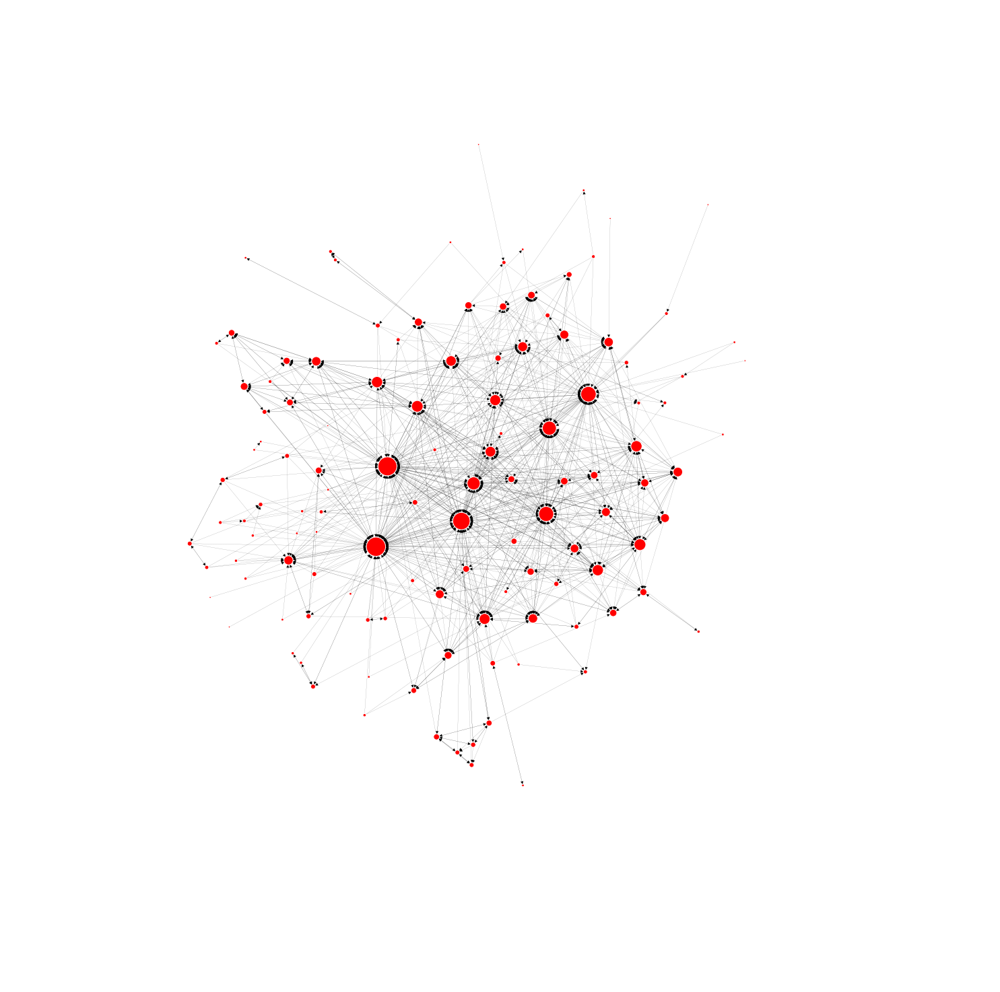

Star Wars: Episode VI Return of the Jedi


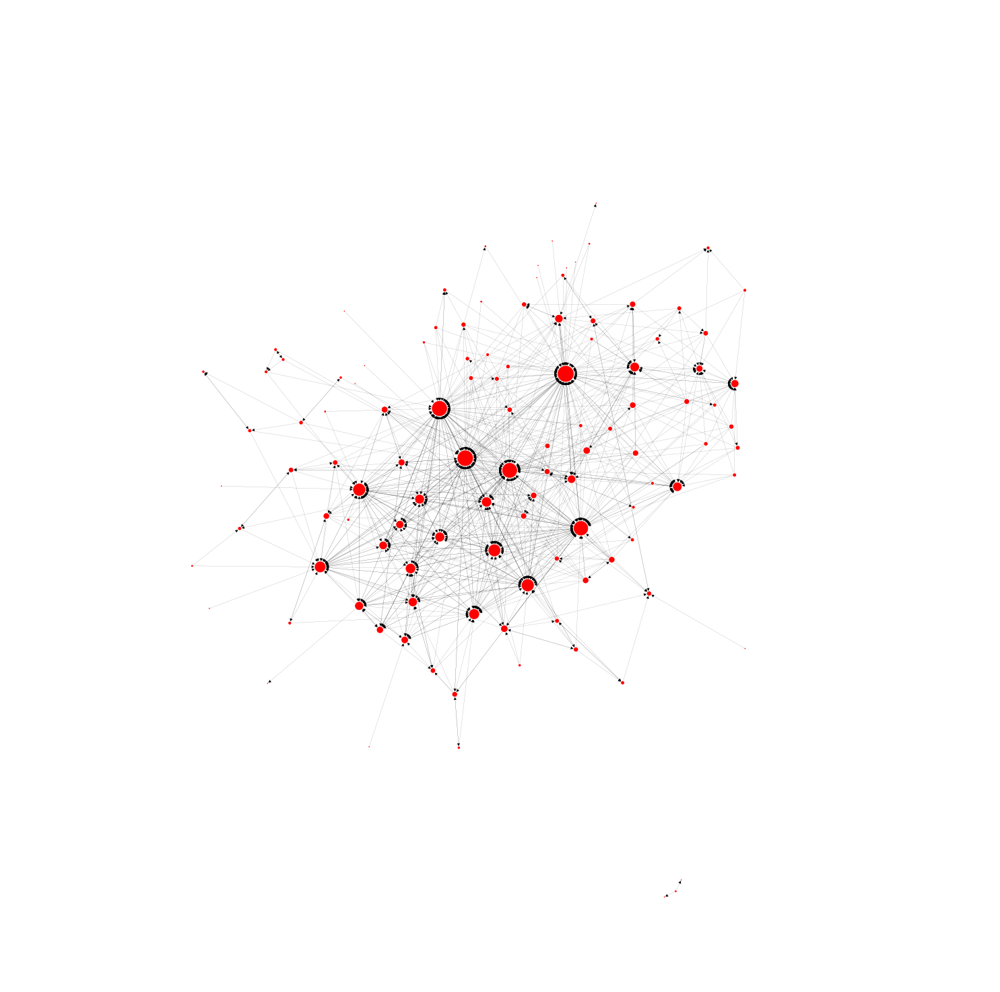

Star Wars: The Clone Wars (series)


<Figure size 3600x2160 with 0 Axes>

Star Wars: The Clone Wars (film)


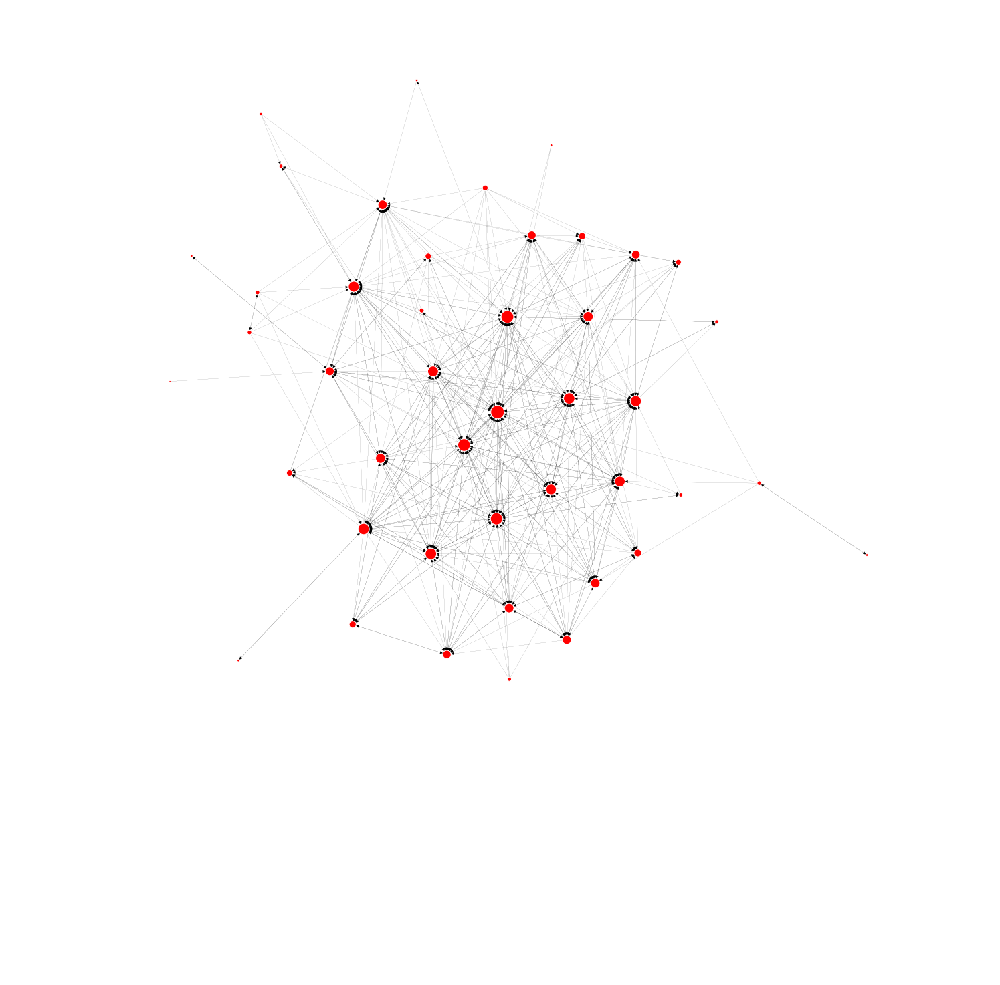

Solo: A Star Wars Story


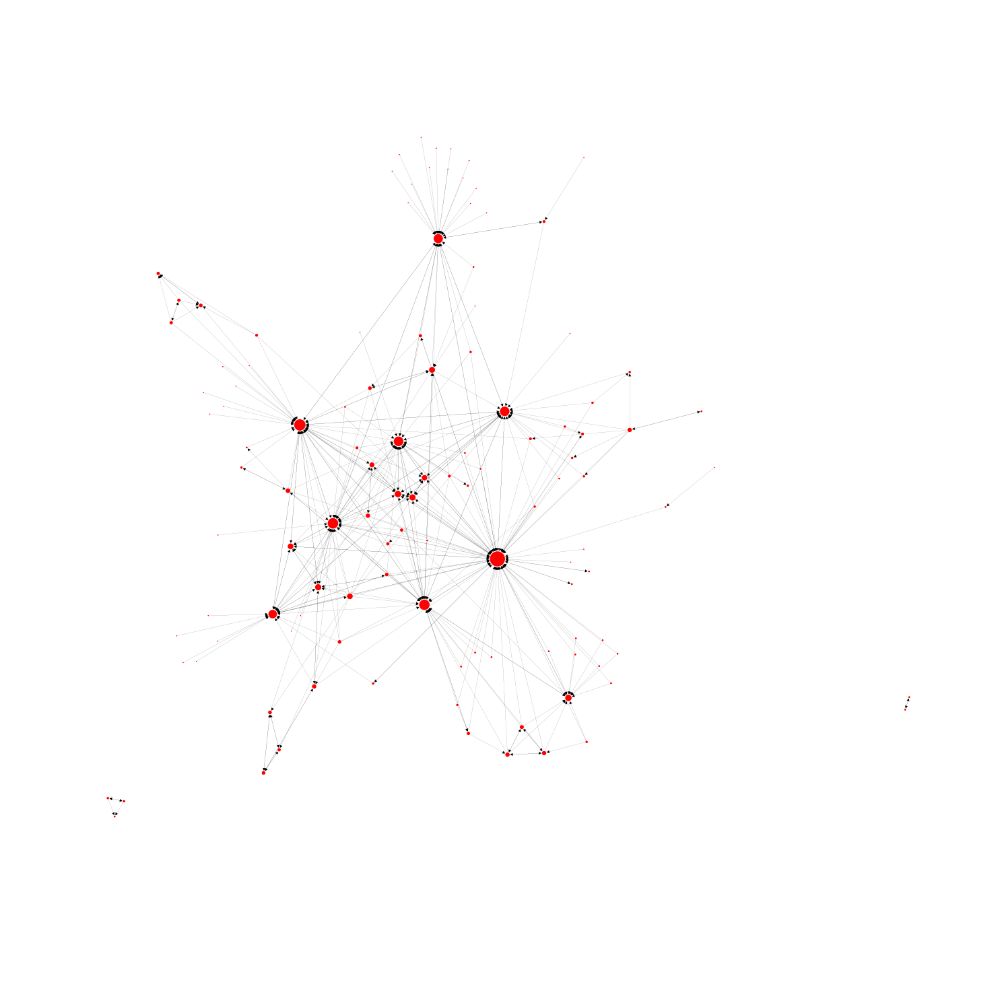

Star Wars: Episode IV A New Hope


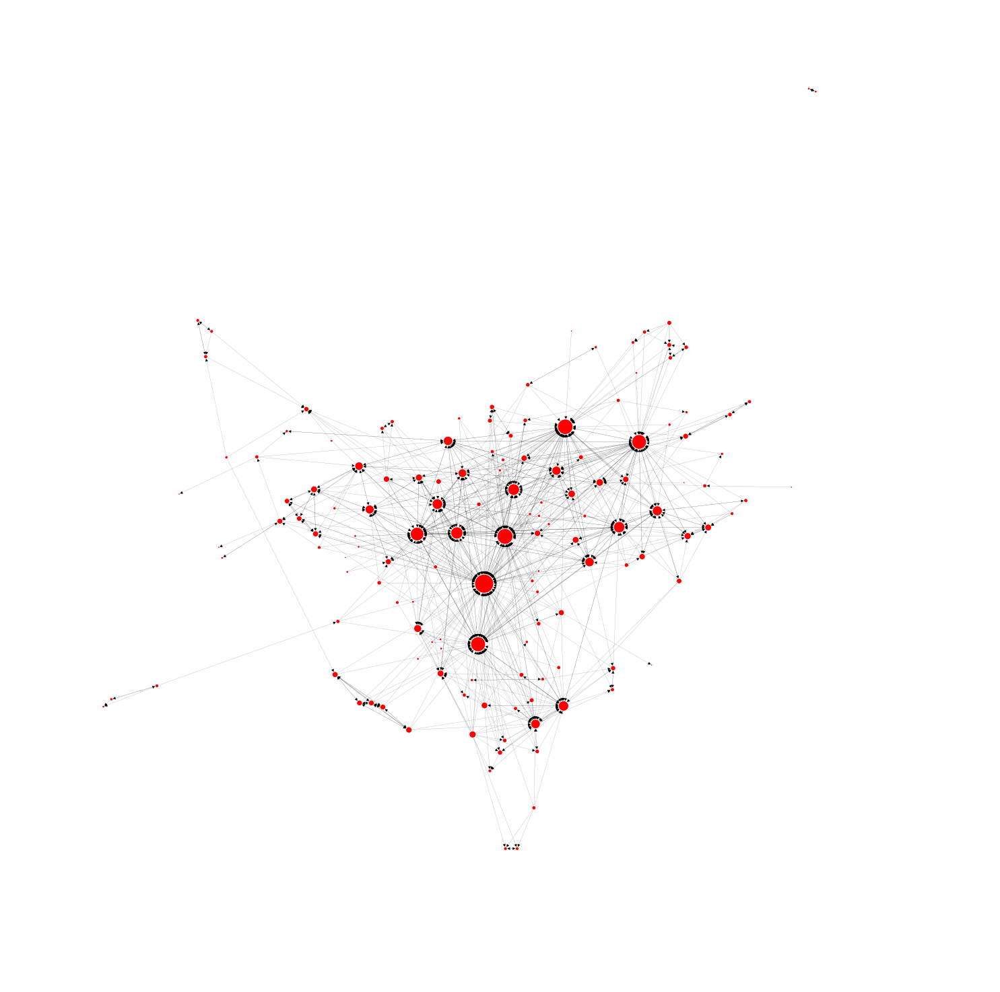

Rogue One: A Star Wars Story


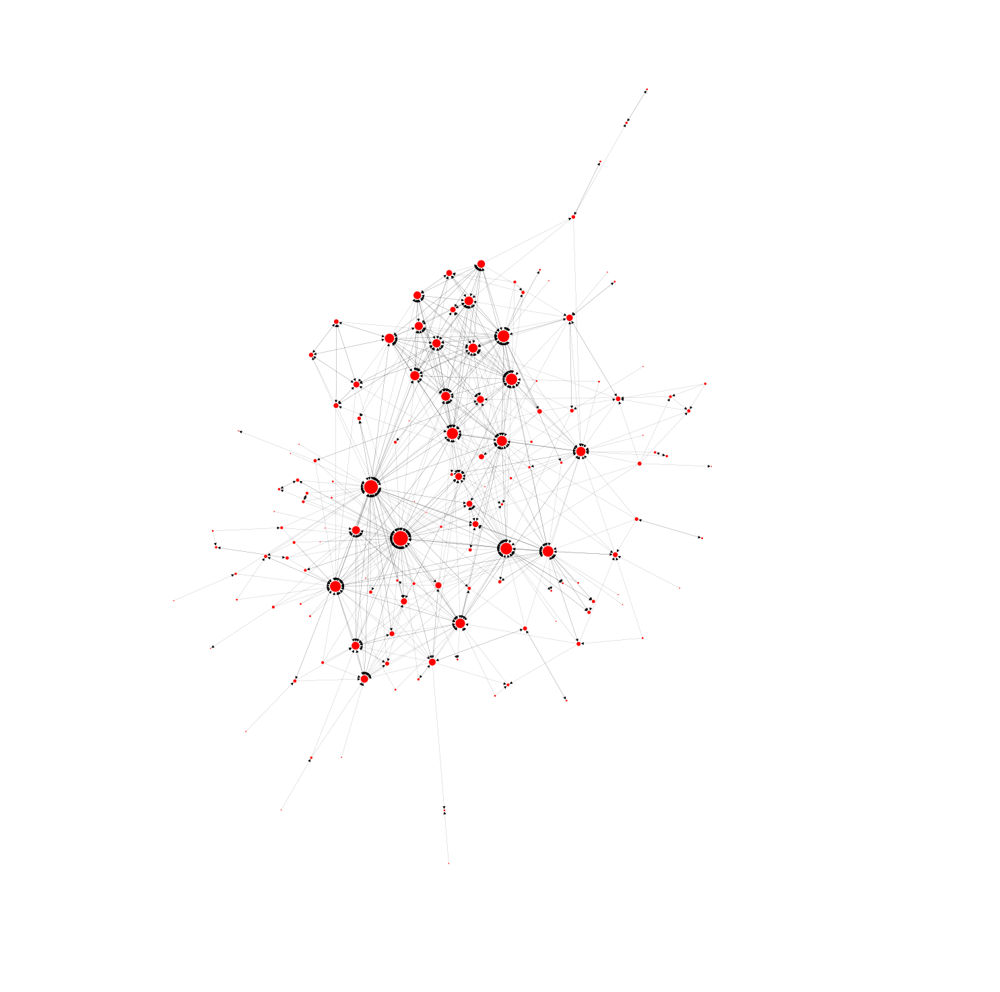

Star Wars: Episode VIII The Last Jedi


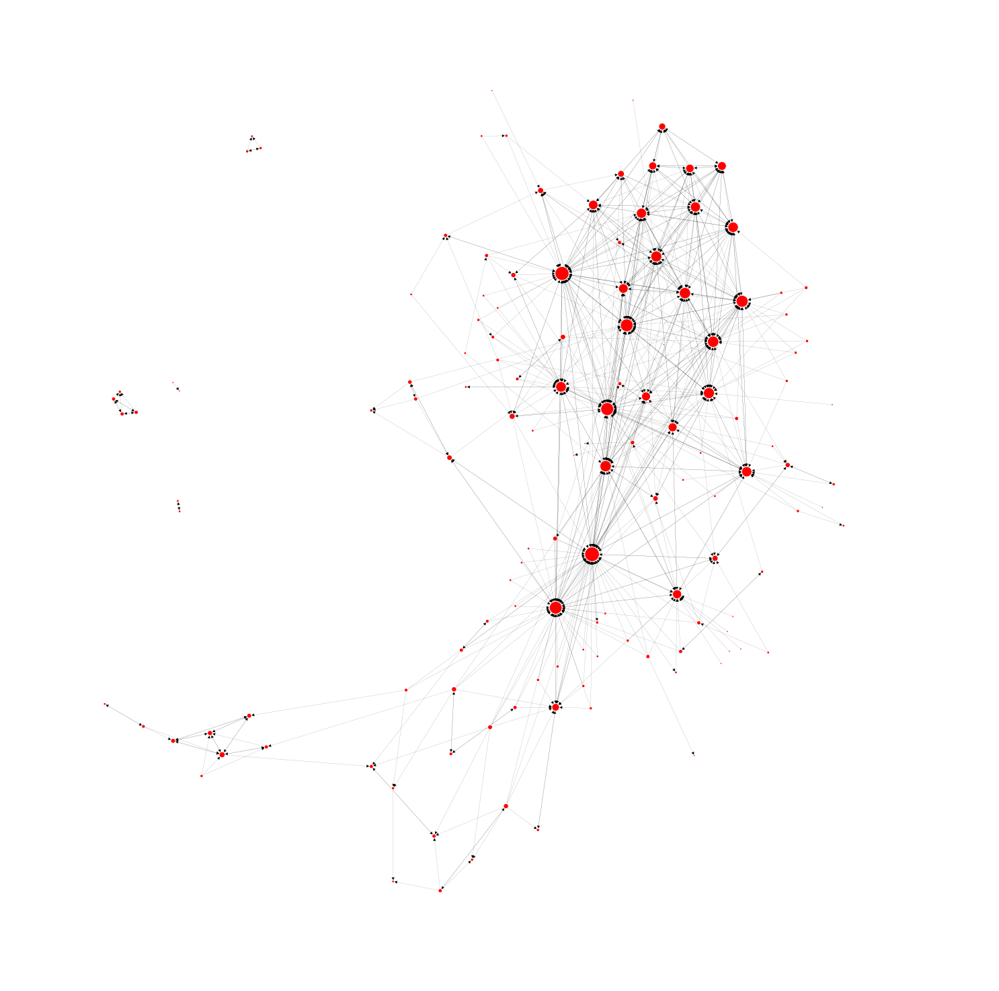

Star Wars: Episode V The Empire Strikes Back


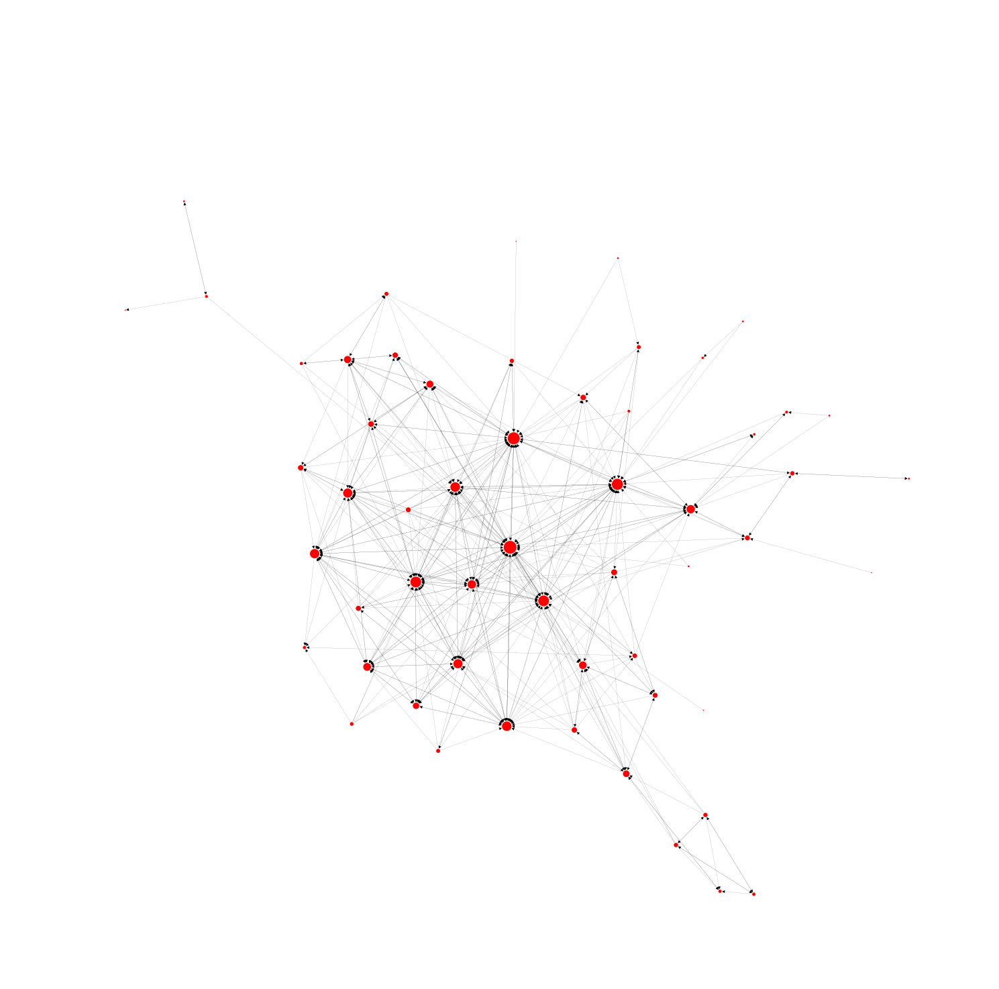

all


<Figure size 3600x2160 with 0 Axes>

Star Wars: Episode III Revenge of the Sith


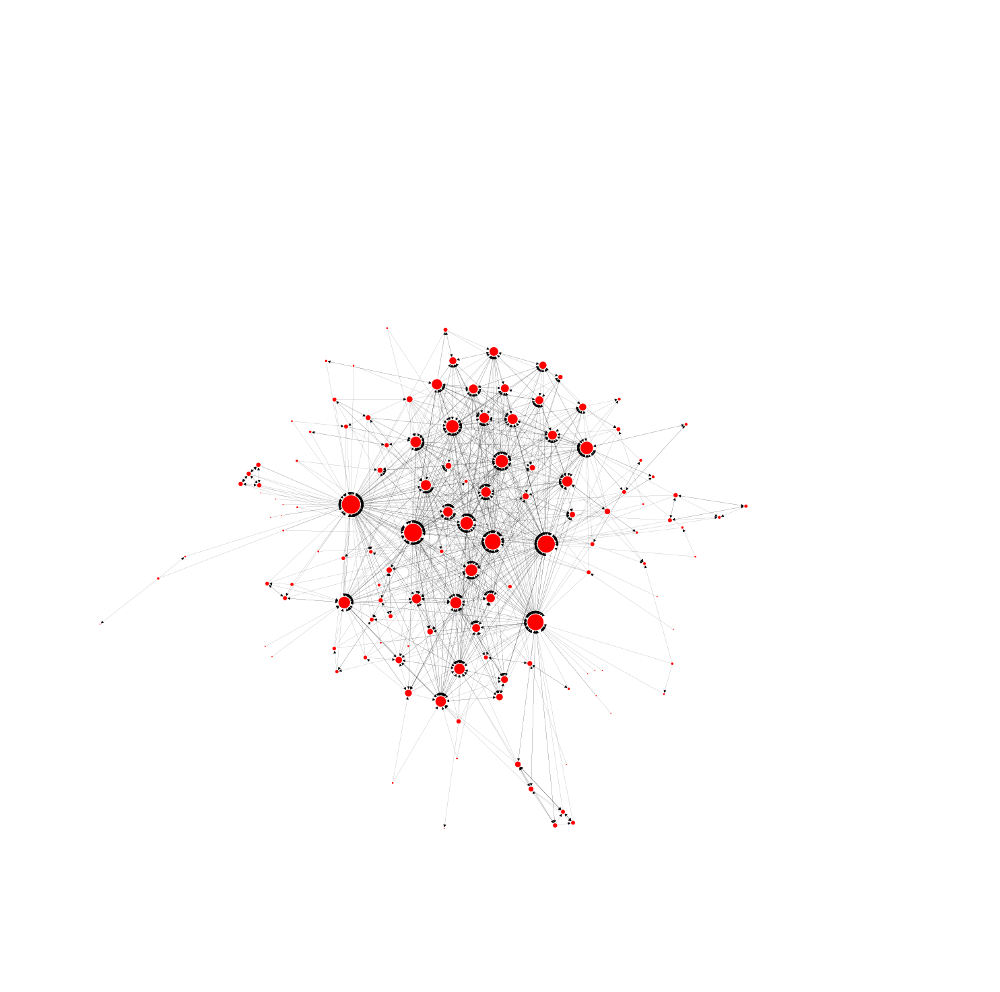

Star Wars Rebels


<Figure size 2160x2160 with 0 Axes>

Star Wars: Episode I The Phantom Menice


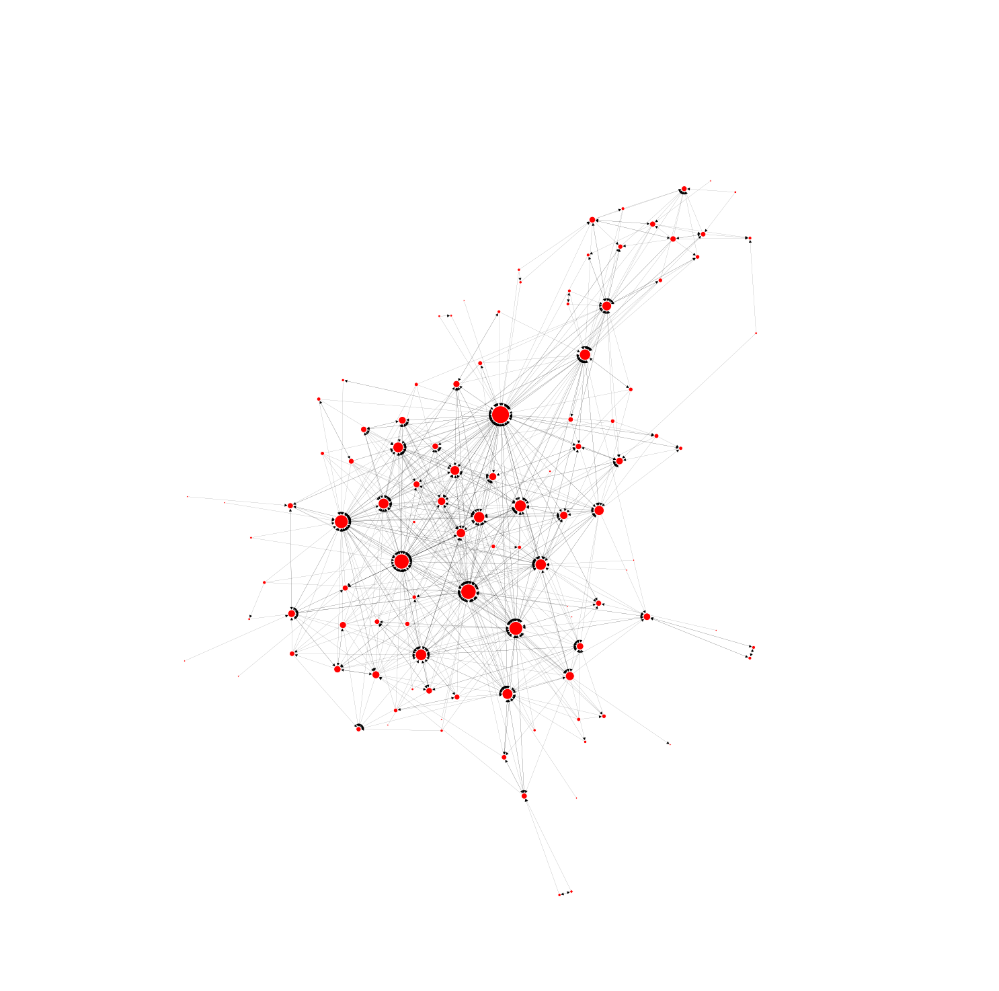

Star Wars: Episode VII The Force Awakens


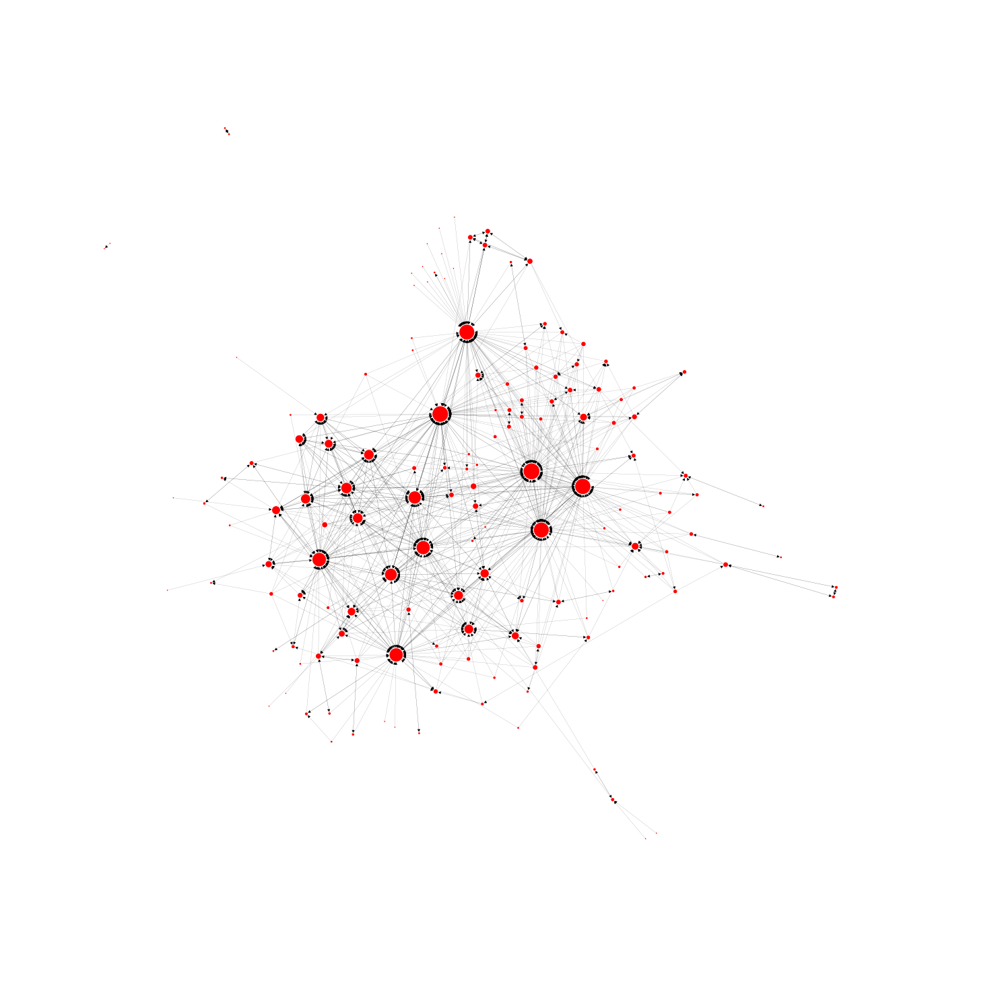

In [8]:
# Read the json file that contains data for the node positions
with open(os.path.join("Data", "movie_networks.json"), 'r') as f:
    starwars_networks = json.load(f)

# Plot all the networks
for dig in digraphs.keys():
    DG = digraphs[dig]["graph"]
    nodes = DG.nodes(data=True)
    nodes_2, degrees = zip(*DG.degree())

    # node size proportional to the degree
    node_sizes_deg = [7*x for x in degrees]

    # # Color according to the party
    # node_colors = ['r' if x[1]['party'] == "Republican" else "b" for x in nodes]
    # nx.draw(DG, positions, node_color=node_colors, node_size=node_sizes_deg, with_labels=False, edgecolors="white", edge_color='k', width=0.1)
    if dig in ("all","Star Wars: The Clone Wars (series)"):
        plt.figure(figsize=(50,30))
    elif dig == "Star Wars Rebels":
        plt.figure(figsize=(30,30))
    else:
        plt.figure(figsize=(20,20))
#     nx.draw(DG, digraphs[dig]["node_pos"], node_color='red', node_size=node_sizes_deg, with_labels=False, edgecolors="white", edge_color='k', width=0.1)
        nx.draw(DG, starwars_networks[dig]["node_pos"], node_color='red', node_size=node_sizes_deg, with_labels=False, edgecolors="white", edge_color='k', width=0.1)
#     plt.title(dig)
    print dig
    directory = os.path.join("Data", dig.replace(" ", "_").replace(":",""))
    if not os.path.exists(directory):
        os.makedirs(directory)
    plt.savefig(os.path.join(directory, "network.png"))
    plt.show()

## Network Analysis

The networks are used to find out what characters are the best connected ones in  each of the Star Wars films and TV-series. We calculate who is best connected with a few different metrics. We use:
+ **Node degree:**
 + The number of edges a node has going in to it and out from it.
+ **In-Degree:
 + The number of edges that come into the node from other nodes.
+ **Out-Degree**
 + The number of edges going from the node to other nodes.
+ **Eigenvector Centrality:** [2,3]
 + With eigenvector centrality we measure the influence of each node in the network. A high eigenvector centrality means that a node is connected to many important nodes, i.e. nodes that have high eigenvector centrality themselfs.
+ **Betweenness centrality:** [4,5]
 + Betweenness centrality assigns score to nodes based on shortest paths. The score of the nodes is proportional to the number of shortest paths between two other nodes that pass through the node.
 
Note that the metrics based on degree only considers the neighbors of a node, but the eigenvector and betweenness centrality consider the nodes in a bigger context. They consider the influence of the node based on all the other nodes in the network. At the end of the next cell tables with the top 10 characters for each network as shown, one for each of these metrics. The network node degree distributions are also shown.





Star Wars: Episode II Attack of the Clones
10 highest degree


name,degree
Obi-Wan Kenobi,116
Anakin Skywalker,112
Padmé Amidala,94
Darth Sidious,74
Mace Windu,70
Dooku,61
Yoda,53
Kit Fisto,43
R2-D2,42
Ki-Adi-Mundi,39


10 highest in-degree


name,in_degree
Obi-Wan Kenobi,78
Anakin Skywalker,69
Padmé Amidala,65
Darth Sidious,51
Mace Windu,42
Dooku,42
Yoda,36
Jango Fett,26
Qui-Gon Jinn,25
Zam Wesell,21


10 highest out-degree


name,out_degree
Anakin Skywalker,43
Obi-Wan Kenobi,38
Padmé Amidala,29
Mace Windu,28
Kit Fisto,28
Ki-Adi-Mundi,27
C-3PO,25
R2-D2,25
Plo Koon,23
Darth Sidious,23


10 highest degree centrality


name,degree_centrality
Obi-Wan Kenobi,0.865672
Anakin Skywalker,0.835821
Padmé Amidala,0.701493
Darth Sidious,0.552239
Mace Windu,0.522388
Dooku,0.455224
Yoda,0.395522
Kit Fisto,0.320896
R2-D2,0.313433
Ki-Adi-Mundi,0.291045


10 highest eigenvector centrality


name,eigenvector_centrality
Obi-Wan Kenobi,0.307808
Anakin Skywalker,0.298269
Padmé Amidala,0.271760
Darth Sidious,0.271590
Dooku,0.261823
Mace Windu,0.246420
Yoda,0.223280
Qui-Gon Jinn,0.212090
Jango Fett,0.195513
Sifo-Dyas,0.164412


10 highest betweenness_centrality


name,betweenness_centrality
Obi-Wan Kenobi,0.125460
Padmé Amidala,0.108068
Anakin Skywalker,0.105221
Darth Sidious,0.040092
Mace Windu,0.029408
Onaconda Farr,0.022502
Dooku,0.017643
Nute Gunray,0.016428
Yoda,0.014520
Wat Tambor,0.014109






Star Wars: Episode VI Return of the Jedi
10 highest degree


name,degree
Jabba Desilijic Tiure,89
Han Solo,84
Luke Skywalker,79
Chewbacca,76
Leia Organa,72
Darth Vader,53
C-3PO,53
R2-D2,51
Darth Sidious,42
Lando Calrissian,37


10 highest in-degree


name,in_degree
Jabba Desilijic Tiure,69
Han Solo,61
Luke Skywalker,58
Chewbacca,53
Leia Organa,48
C-3PO,35
Darth Vader,32
R2-D2,32
Darth Sidious,27
Boushh,24


10 highest out-degree


name,out_degree
Leia Organa,24
Han Solo,23
Chewbacca,23
Darth Vader,21
Luke Skywalker,21
Jabba Desilijic Tiure,20
R2-D2,19
C-3PO,18
Gial Ackbar,18
J'Quille,16


10 highest degree centrality


name,degree_centrality
Jabba Desilijic Tiure,0.729508
Han Solo,0.688525
Luke Skywalker,0.647541
Chewbacca,0.622951
Leia Organa,0.590164
Darth Vader,0.434426
C-3PO,0.434426
R2-D2,0.418033
Darth Sidious,0.344262
Lando Calrissian,0.303279


10 highest eigenvector centrality


name,eigenvector_centrality
Leia Organa,0.276571
Luke Skywalker,0.276156
Darth Vader,0.272629
Han Solo,0.272400
Chewbacca,0.268385
Darth Sidious,0.259315
Jabba Desilijic Tiure,0.256700
R2-D2,0.242137
Anakin Skywalker,0.227333
C-3PO,0.226934


10 highest betweenness_centrality


name,betweenness_centrality
Jabba Desilijic Tiure,0.077804
Han Solo,0.065835
Darth Vader,0.044969
Chewbacca,0.043663
Luke Skywalker,0.040373
Leia Organa,0.037203
Sy Snootles,0.032460
Bossk,0.021542
Darth Sidious,0.016198
Pateesa,0.015446






Star Wars: The Clone Wars (series)
10 highest degree


name,degree
Anakin Skywalker,377
Obi-Wan Kenobi,301
Ahsoka Tano,269
Dooku,225
Darth Sidious,174
Padmé Amidala,174
Rex,166
Darth Vader,158
Asajj Ventress,145
R2-D2,145


10 highest in-degree


name,in_degree
Anakin Skywalker,205
Ahsoka Tano,180
Obi-Wan Kenobi,172
Dooku,143
Darth Sidious,118
Padmé Amidala,106
Grievous,99
Asajj Ventress,79
Rex,78
Yoda,77


10 highest out-degree


name,out_degree
Anakin Skywalker,172
Obi-Wan Kenobi,129
Darth Vader,94
Ahsoka Tano,89
Rex,88
Dooku,82
R2-D2,81
Padmé Amidala,68
Asajj Ventress,66
Mace Windu,64


10 highest degree centrality


name,degree_centrality
Anakin Skywalker,0.564371
Obi-Wan Kenobi,0.450599
Ahsoka Tano,0.402695
Dooku,0.336826
Padmé Amidala,0.260479
Darth Sidious,0.260479
Rex,0.248503
Darth Vader,0.236527
R2-D2,0.217066
Asajj Ventress,0.217066


10 highest eigenvector centrality


name,eigenvector_centrality
Anakin Skywalker,0.273608
Obi-Wan Kenobi,0.247501
Dooku,0.238567
Ahsoka Tano,0.231647
Darth Sidious,0.219684
Padmé Amidala,0.198095
Darth Vader,0.171201
Mace Windu,0.162220
Asajj Ventress,0.157907
Grievous,0.155990


10 highest betweenness_centrality


name,betweenness_centrality
Anakin Skywalker,0.125878
Ahsoka Tano,0.093163
Obi-Wan Kenobi,0.078914
Dooku,0.043205
R2-D2,0.042619
Rex,0.039402
Asajj Ventress,0.039272
Padmé Amidala,0.033998
Grievous,0.027800
Darth Sidious,0.025595






Star Wars: The Clone Wars (film)
10 highest degree


name,degree
Anakin Skywalker,58
Ahsoka Tano,51
Obi-Wan Kenobi,49
Darth Sidious,47
Padmé Amidala,41
Asajj Ventress,40
Mace Windu,40
Dooku,39
Jabba Desilijic Tiure,37
R2-D2,36


10 highest in-degree


name,in_degree
Anakin Skywalker,30
Darth Sidious,27
Ahsoka Tano,26
Obi-Wan Kenobi,24
Dooku,24
Jabba Desilijic Tiure,24
Rotta,23
Padmé Amidala,22
Asajj Ventress,21
Grievous,21


10 highest out-degree


name,out_degree
Anakin Skywalker,28
Ahsoka Tano,25
Obi-Wan Kenobi,25
Mace Windu,20
R2-D2,20
Darth Sidious,20
Padmé Amidala,19
Asajj Ventress,19
C-3PO,18
Rex,18


10 highest degree centrality


name,degree_centrality
Anakin Skywalker,1.260870
Ahsoka Tano,1.108696
Obi-Wan Kenobi,1.065217
Darth Sidious,1.021739
Padmé Amidala,0.891304
Mace Windu,0.869565
Asajj Ventress,0.869565
Dooku,0.847826
Jabba Desilijic Tiure,0.804348
R2-D2,0.782609


10 highest eigenvector centrality


name,eigenvector_centrality
Dooku,0.274130
Anakin Skywalker,0.266522
Darth Sidious,0.266310
Ahsoka Tano,0.265217
Obi-Wan Kenobi,0.256585
Asajj Ventress,0.249779
Padmé Amidala,0.228637
Grievous,0.224817
Jabba Desilijic Tiure,0.222405
Yoda,0.220870


10 highest betweenness_centrality


name,betweenness_centrality
Anakin Skywalker,0.111326
Ahsoka Tano,0.087452
Ziro Desilijic Tiure/Canon,0.059933
Mace Windu,0.054233
Jabba Desilijic Tiure,0.042122
Obi-Wan Kenobi,0.041849
Darth Sidious,0.038063
Asajj Ventress,0.030261
Rotta,0.029941
Dooku,0.029431






Solo: A Star Wars Story
10 highest degree


name,degree
Han Solo,79
Dryden Vos,46
Tobias Beckett,40
Qi'ra,39
Chewbacca,34
Lando Calrissian,33
L3-37,31
Enfys Nest,27
Maul,16
Proxima,16


10 highest in-degree


name,in_degree
Han Solo,62
Dryden Vos,32
Tobias Beckett,29
Qi'ra,26
L3-37,25
Lando Calrissian,24
Chewbacca,23
Enfys Nest,19
Proxima,14
Jabba Desilijic Tiure,9


10 highest out-degree


name,out_degree
Han Solo,17
Dryden Vos,14
Qi'ra,13
Weazel,12
Tobias Beckett,11
Chewbacca,11
Lando Calrissian,9
Enfys Nest,8
Maul,8
Rio Durant,8


10 highest degree centrality


name,degree_centrality
Han Solo,0.533784
Dryden Vos,0.310811
Tobias Beckett,0.270270
Qi'ra,0.263514
Chewbacca,0.229730
Lando Calrissian,0.222973
L3-37,0.209459
Enfys Nest,0.182432
Maul,0.108108
Proxima,0.108108


10 highest eigenvector centrality


name,eigenvector_centrality
Han Solo,0.393430
Tobias Beckett,0.349681
Dryden Vos,0.320771
Lando Calrissian,0.309090
Chewbacca,0.295900
Enfys Nest,0.264451
Qi'ra,0.261786
Maul,0.237562
Jabba Desilijic Tiure,0.234640
L3-37,0.223207


10 highest betweenness_centrality


name,betweenness_centrality
Han Solo,0.068700
Qi'ra,0.045443
Dryden Vos,0.039365
L3-37,0.029906
Enfys Nest,0.028337
Tobias Beckett,0.020560
Lando Calrissian,0.015009
Falthina Sharest,0.014755
Chewbacca,0.014197
Quay Tolsite,0.012739






Star Wars: Episode IV A New Hope
10 highest degree


name,degree
Luke Skywalker,113
Han Solo,77
Leia Organa,74
Obi-Wan Kenobi,69
Darth Vader,67
R2-D2,57
C-3PO,46
Chewbacca,42
Darth Sidious,40
Jabba Desilijic Tiure,35


10 highest in-degree


name,in_degree
Luke Skywalker,88
Leia Organa,55
Han Solo,54
Obi-Wan Kenobi,51
Darth Vader,45
R2-D2,38
C-3PO,30
Chewbacca,29
Darth Sidious,26
Jabba Desilijic Tiure,22


10 highest out-degree


name,out_degree
Luke Skywalker,25
Han Solo,23
Darth Vader,22
Leia Organa,19
R2-D2,19
Obi-Wan Kenobi,18
C-3PO,16
Cobb Sonbepol,15
Darth Sidious,14
Cornelius Evazan,14


10 highest degree centrality


name,degree_centrality
Luke Skywalker,0.748344
Han Solo,0.509934
Leia Organa,0.490066
Obi-Wan Kenobi,0.456954
Darth Vader,0.443709
R2-D2,0.377483
C-3PO,0.304636
Chewbacca,0.278146
Darth Sidious,0.264901
Jabba Desilijic Tiure,0.231788


10 highest eigenvector centrality


name,eigenvector_centrality
Luke Skywalker,0.340007
Leia Organa,0.294877
Darth Vader,0.287019
R2-D2,0.274614
Han Solo,0.273164
Obi-Wan Kenobi,0.270072
Darth Sidious,0.260778
Chewbacca,0.242253
C-3PO,0.232906
Jabba Desilijic Tiure,0.226946


10 highest betweenness_centrality


name,betweenness_centrality
Luke Skywalker,0.105603
Han Solo,0.075391
Darth Vader,0.051267
Obi-Wan Kenobi,0.042205
Cornelius Evazan,0.041568
Leia Organa,0.030949
Wedge Antilles,0.029288
R2-D2,0.025604
Jek Tono Porkins,0.025227
Wilhuff Tarkin,0.016336






Rogue One: A Star Wars Story
10 highest degree


name,degree
Jyn Erso,74
Saw Gerrera,66
Galen Walton Erso,48
Darth Vader,48
Leia Organa,45
Mon Mothma,44
Cassian Jeron Andor,42
Orson Callan Krennic,41
Wilhuff Tarkin,37
Bodhi Rook,33


10 highest in-degree


name,in_degree
Jyn Erso,53
Saw Gerrera,44
Galen Walton Erso,33
Cassian Jeron Andor,31
Darth Vader,28
Leia Organa,28
Mon Mothma,23
Orson Callan Krennic,22
Wilhuff Tarkin,21
Raddus,21


10 highest out-degree


name,out_degree
Saw Gerrera,22
Jyn Erso,21
Mon Mothma,21
Darth Vader,20
Orson Callan Krennic,19
Hera Syndulla,19
Leia Organa,17
Wilhuff Tarkin,16
Bail Organa,16
Jan Dodonna,15


10 highest degree centrality


name,degree_centrality
Jyn Erso,0.415730
Saw Gerrera,0.370787
Darth Vader,0.269663
Galen Walton Erso,0.269663
Leia Organa,0.252809
Mon Mothma,0.247191
Cassian Jeron Andor,0.235955
Orson Callan Krennic,0.230337
Wilhuff Tarkin,0.207865
Bodhi Rook,0.185393


10 highest eigenvector centrality


name,eigenvector_centrality
Saw Gerrera,0.293427
Leia Organa,0.285235
Darth Vader,0.279661
Darth Sidious,0.273147
Wilhuff Tarkin,0.260630
Mon Mothma,0.256596
Bail Organa,0.232634
Galen Walton Erso,0.231931
Obi-Wan Kenobi,0.214919
R2-D2,0.206543


10 highest betweenness_centrality


name,betweenness_centrality
Jyn Erso,0.085783
Saw Gerrera,0.065510
Darth Vader,0.049471
Orson Callan Krennic,0.034472
Mon Mothma,0.032107
Raddus,0.026808
Galen Walton Erso,0.025718
Ruescott Melshi,0.019798
Cassian Jeron Andor,0.019739
Leia Organa,0.018695


D:\Anaconda2\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)






Star Wars: Episode VIII The Last Jedi
10 highest degree


name,degree
Finn,67
Leia Organa,61
Poe Dameron,53
Luke Skywalker,51
Rose Tico,51
Kylo Ren,45
Rey,40
Han Solo,40
BB-8,40
Snoke,38


10 highest in-degree


name,in_degree
Finn,45
Rose Tico,39
Leia Organa,35
Poe Dameron,32
Luke Skywalker,32
Kylo Ren,28
Rey,26
Snoke,24
Amilyn Holdo,24
BB-8,22


10 highest out-degree


name,out_degree
Leia Organa,26
Finn,22
Poe Dameron,21
Han Solo,21
Luke Skywalker,19
BB-8,18
Chewbacca,18
Kylo Ren,17
Phasma,17
C-3PO,17


10 highest degree centrality


name,degree_centrality
Finn,0.403614
Leia Organa,0.367470
Poe Dameron,0.319277
Luke Skywalker,0.307229
Rose Tico,0.307229
Kylo Ren,0.271084
BB-8,0.240964
Rey,0.240964
Han Solo,0.240964
Snoke,0.228916


10 highest eigenvector centrality


name,eigenvector_centrality
Leia Organa,0.283541
Luke Skywalker,0.282521
Rey,0.265234
Kylo Ren,0.252771
Chewbacca,0.250176
Han Solo,0.249915
Finn,0.222676
Darth Sidious,0.221542
Darth Vader,0.221129
BB-8,0.215289


10 highest betweenness_centrality


name,betweenness_centrality
Finn,0.047529
Leia Organa,0.025341
Poe Dameron,0.018540
Rose Tico,0.018292
Amilyn Holdo,0.013193
BB-8,0.011949
Temiri Blagg,0.011872
DJ,0.011841
Luke Skywalker,0.011424
Armitage Hux,0.010525






Star Wars: Episode V The Empire Strikes Back
10 highest degree


name,degree
Darth Vader,58
Han Solo,52
Luke Skywalker,45
Leia Organa,42
Chewbacca,42
C-3PO,34
Darth Sidious,33
Jabba Desilijic Tiure,32
R2-D2,31
Boba Fett,31


10 highest in-degree


name,in_degree
Darth Vader,34
Han Solo,31
Luke Skywalker,30
Leia Organa,26
Chewbacca,26
C-3PO,22
Darth Sidious,21
Jabba Desilijic Tiure,19
R2-D2,19
Boba Fett,17


10 highest out-degree


name,out_degree
Darth Vader,24
Han Solo,21
Chewbacca,16
Leia Organa,16
Luke Skywalker,15
Boba Fett,14
Jabba Desilijic Tiure,13
Wedge Antilles,13
Lando Calrissian,12
Firmus Piett,12


10 highest degree centrality


name,degree_centrality
Darth Vader,0.906250
Han Solo,0.812500
Luke Skywalker,0.703125
Chewbacca,0.656250
Leia Organa,0.656250
C-3PO,0.531250
Darth Sidious,0.515625
Jabba Desilijic Tiure,0.500000
Boba Fett,0.484375
R2-D2,0.484375


10 highest eigenvector centrality


name,eigenvector_centrality
Darth Vader,0.307610
Chewbacca,0.299516
Han Solo,0.298639
Luke Skywalker,0.289711
Jabba Desilijic Tiure,0.273704
Darth Sidious,0.272690
Leia Organa,0.272002
R2-D2,0.261049
Boba Fett,0.246320
C-3PO,0.241982


10 highest betweenness_centrality


name,betweenness_centrality
Darth Vader,0.152963
Han Solo,0.089216
Luke Skywalker,0.061327
Wedge Antilles,0.036876
4-LOM,0.032458
Ciena Ree,0.029724
Leia Organa,0.027837
Zev Senesca,0.022252
Firmus Piett,0.021658
Chewbacca,0.021648






all
10 highest degree


name,degree
Anakin Skywalker,512
Obi-Wan Kenobi,436
Darth Vader,334
Darth Sidious,326
Ahsoka Tano,318
Han Solo,302
Ezra Bridger,276
Luke Skywalker,256
R2-D2,251
Leia Organa,250


10 highest in-degree


name,in_degree
Anakin Skywalker,314
Obi-Wan Kenobi,290
Darth Sidious,249
Han Solo,230
Ahsoka Tano,209
Luke Skywalker,201
Darth Vader,190
Leia Organa,178
Padmé Amidala,170
Dooku,157


10 highest out-degree


name,out_degree
Anakin Skywalker,198
Obi-Wan Kenobi,146
Darth Vader,144
Ezra Bridger,124
Rex,116
R2-D2,110
Ahsoka Tano,109
Sabine Wren,107
C1-10P,104
Hera Syndulla,102


10 highest degree centrality


name,degree_centrality
Anakin Skywalker,0.263374
Obi-Wan Kenobi,0.224280
Darth Vader,0.171811
Darth Sidious,0.167695
Ahsoka Tano,0.163580
Han Solo,0.155350
Ezra Bridger,0.141975
Luke Skywalker,0.131687
R2-D2,0.129115
Leia Organa,0.128601


10 highest eigenvector centrality


name,eigenvector_centrality
Darth Sidious,0.224919
Anakin Skywalker,0.221756
Obi-Wan Kenobi,0.216027
Ahsoka Tano,0.203891
Darth Vader,0.198796
Dooku,0.172426
Ezra Bridger,0.163220
Padmé Amidala,0.155790
R2-D2,0.151021
Maul,0.146495


10 highest betweenness_centrality


name,betweenness_centrality
Anakin Skywalker,0.060158
Obi-Wan Kenobi,0.044017
Han Solo,0.036928
Ahsoka Tano,0.032224
Darth Vader,0.032213
Darth Sidious,0.026189
R2-D2,0.025782
Leia Organa,0.023461
Ezra Bridger,0.021547
Padmé Amidala,0.020012






Star Wars: Episode III Revenge of the Sith
10 highest degree


name,degree
Darth Sidious,114
Anakin Skywalker,108
Obi-Wan Kenobi,100
Padmé Amidala,89
Darth Vader,85
Yoda,55
Grievous,55
Dooku,55
Mace Windu,55
R2-D2,49


10 highest in-degree


name,in_degree
Darth Sidious,87
Anakin Skywalker,66
Obi-Wan Kenobi,63
Padmé Amidala,60
Darth Vader,52
Dooku,38
Yoda,35
Grievous,34
Mace Windu,31
Bail Organa,31


10 highest out-degree


name,out_degree
Anakin Skywalker,42
Obi-Wan Kenobi,37
Darth Vader,33
Padmé Amidala,29
Darth Sidious,27
R2-D2,26
Ki-Adi-Mundi,26
C-3PO,24
Mace Windu,24
Kit Fisto,23


10 highest degree centrality


name,degree_centrality
Darth Sidious,0.802817
Anakin Skywalker,0.760563
Obi-Wan Kenobi,0.704225
Padmé Amidala,0.626761
Darth Vader,0.598592
Grievous,0.387324
Dooku,0.387324
Yoda,0.387324
Mace Windu,0.387324
R2-D2,0.345070


10 highest eigenvector centrality


name,eigenvector_centrality
Anakin Skywalker,0.281416
Obi-Wan Kenobi,0.279915
Darth Sidious,0.276108
Darth Vader,0.260253
Padmé Amidala,0.251640
Dooku,0.236891
Yoda,0.211020
Mace Windu,0.200914
Grievous,0.197168
Qui-Gon Jinn,0.188650


10 highest betweenness_centrality


name,betweenness_centrality
Anakin Skywalker,0.103011
Padmé Amidala,0.098153
Darth Sidious,0.095591
Obi-Wan Kenobi,0.066475
Darth Vader,0.050202
Mas Amedda,0.036948
Grievous,0.029873
Bail Organa,0.026477
Nute Gunray,0.021148
Ki-Adi-Mundi,0.015588






Star Wars Rebels
10 highest degree


name,degree
Ezra Bridger,273
Sabine Wren,206
Kanan Jarrus,198
C1-10P,190
Hera Syndulla,176
Garazeb Orrelios,176
Alexsandr Kallus,115
Darth Sidious,113
Mitth'raw'nuruodo,106
Ahsoka Tano,104


10 highest in-degree


name,in_degree
Ezra Bridger,150
Kanan Jarrus,101
Sabine Wren,100
C1-10P,88
Hera Syndulla,84
Garazeb Orrelios,79
Darth Sidious,77
Mitth'raw'nuruodo,71
Ahsoka Tano,62
Darth Vader,60


10 highest out-degree


name,out_degree
Ezra Bridger,123
Sabine Wren,106
C1-10P,102
Kanan Jarrus,97
Garazeb Orrelios,97
Hera Syndulla,92
Alexsandr Kallus,56
Rex,50
Darth Vader,44
Ahsoka Tano,42


10 highest degree centrality


name,degree_centrality
Ezra Bridger,1.041985
Sabine Wren,0.786260
Kanan Jarrus,0.755725
C1-10P,0.725191
Garazeb Orrelios,0.671756
Hera Syndulla,0.671756
Alexsandr Kallus,0.438931
Darth Sidious,0.431298
Mitth'raw'nuruodo,0.404580
Darth Vader,0.396947


10 highest eigenvector centrality


name,eigenvector_centrality
Ezra Bridger,0.266832
Kanan Jarrus,0.210398
C1-10P,0.203526
Darth Sidious,0.194713
Sabine Wren,0.191880
Hera Syndulla,0.183108
Darth Vader,0.181726
Ahsoka Tano,0.171558
Mitth'raw'nuruodo,0.169470
Alexsandr Kallus,0.154571


10 highest betweenness_centrality


name,betweenness_centrality
Ezra Bridger,0.158501
Sabine Wren,0.098101
Kanan Jarrus,0.075941
C1-10P,0.059684
Garazeb Orrelios,0.059586
Hera Syndulla,0.055817
Alexsandr Kallus,0.026140
Mitth'raw'nuruodo,0.021891
Ahsoka Tano,0.021067
Darth Sidious,0.019688






Star Wars: Episode I The Phantom Menice
10 highest degree


name,degree
Anakin Skywalker,98
Padmé Amidala,73
Obi-Wan Kenobi,71
Qui-Gon Jinn,59
Darth Sidious,59
R2-D2,44
Nute Gunray,41
Jar Jar Binks,40
Jabba Desilijic Tiure,39
Mace Windu,39


10 highest in-degree


name,in_degree
Anakin Skywalker,62
Padmé Amidala,52
Obi-Wan Kenobi,47
Qui-Gon Jinn,45
Darth Sidious,40
Jabba Desilijic Tiure,28
Maul,25
Finis Valorum,25
R2-D2,23
Jar Jar Binks,23


10 highest out-degree


name,out_degree
Anakin Skywalker,36
Obi-Wan Kenobi,24
R2-D2,21
Padmé Amidala,21
Mace Windu,20
Darth Sidious,19
Nute Gunray,19
C-3PO,19
Ki-Adi-Mundi,18
Plo Koon,18


10 highest degree centrality


name,degree_centrality
Anakin Skywalker,0.796748
Padmé Amidala,0.593496
Obi-Wan Kenobi,0.577236
Darth Sidious,0.479675
Qui-Gon Jinn,0.479675
R2-D2,0.357724
Nute Gunray,0.333333
Jar Jar Binks,0.325203
Mace Windu,0.317073
Jabba Desilijic Tiure,0.317073


10 highest eigenvector centrality


name,eigenvector_centrality
Anakin Skywalker,0.321769
Obi-Wan Kenobi,0.311599
Padmé Amidala,0.299189
Qui-Gon Jinn,0.284112
Darth Sidious,0.282491
Maul,0.231829
Yoda,0.221947
Mace Windu,0.206414
Finis Valorum,0.203370
R2-D2,0.194309


10 highest betweenness_centrality


name,betweenness_centrality
Anakin Skywalker,0.153712
Padmé Amidala,0.085154
Sebulba,0.050845
Obi-Wan Kenobi,0.038467
Nute Gunray,0.036432
Qui-Gon Jinn,0.033982
Darth Sidious,0.032992
Jabba Desilijic Tiure,0.031195
Jar Jar Binks,0.028246
Mas Amedda,0.024801






Star Wars: Episode VII The Force Awakens
10 highest degree


name,degree
Rey,87
Han Solo,84
Finn,80
Maz Kanata,77
BB-8,77
Leia Organa,64
Luke Skywalker,62
Poe Dameron,62
Chewbacca,54
Kylo Ren,50


10 highest in-degree


name,in_degree
Rey,65
Han Solo,62
BB-8,59
Finn,58
Maz Kanata,52
Poe Dameron,42
Luke Skywalker,40
Leia Organa,36
Chewbacca,32
Kylo Ren,31


10 highest out-degree


name,out_degree
Leia Organa,28
Maz Kanata,25
Rey,22
Finn,22
Luke Skywalker,22
Chewbacca,22
Han Solo,22
Poe Dameron,20
Kylo Ren,19
BB-8,18


10 highest degree centrality


name,degree_centrality
Rey,0.508772
Han Solo,0.491228
Finn,0.467836
BB-8,0.450292
Maz Kanata,0.450292
Leia Organa,0.374269
Luke Skywalker,0.362573
Poe Dameron,0.362573
Chewbacca,0.315789
Kylo Ren,0.292398


10 highest eigenvector centrality


name,eigenvector_centrality
Luke Skywalker,0.290803
Han Solo,0.288189
Leia Organa,0.276763
Kylo Ren,0.265502
Chewbacca,0.265211
Rey,0.250084
Anakin Skywalker,0.230923
Darth Sidious,0.222696
BB-8,0.215175
Poe Dameron,0.209100


10 highest betweenness_centrality


name,betweenness_centrality
Maz Kanata,0.081734
Rey,0.054921
Finn,0.044657
Kylo Ren,0.039661
Leia Organa,0.039412
Poe Dameron,0.032637
BB-8,0.029703
Han Solo,0.029632
Luke Skywalker,0.023253
Ello Asty,0.015228


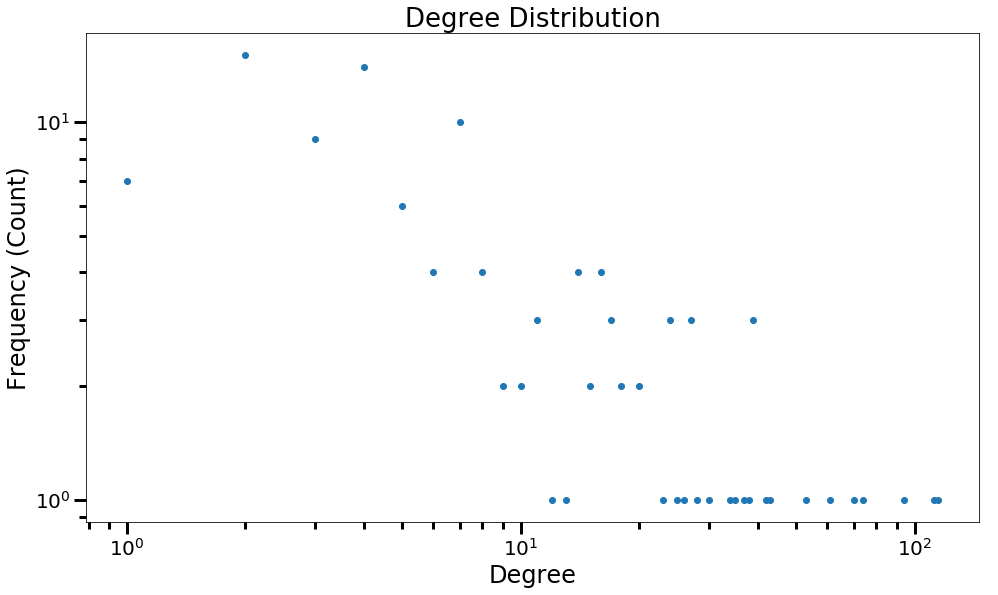

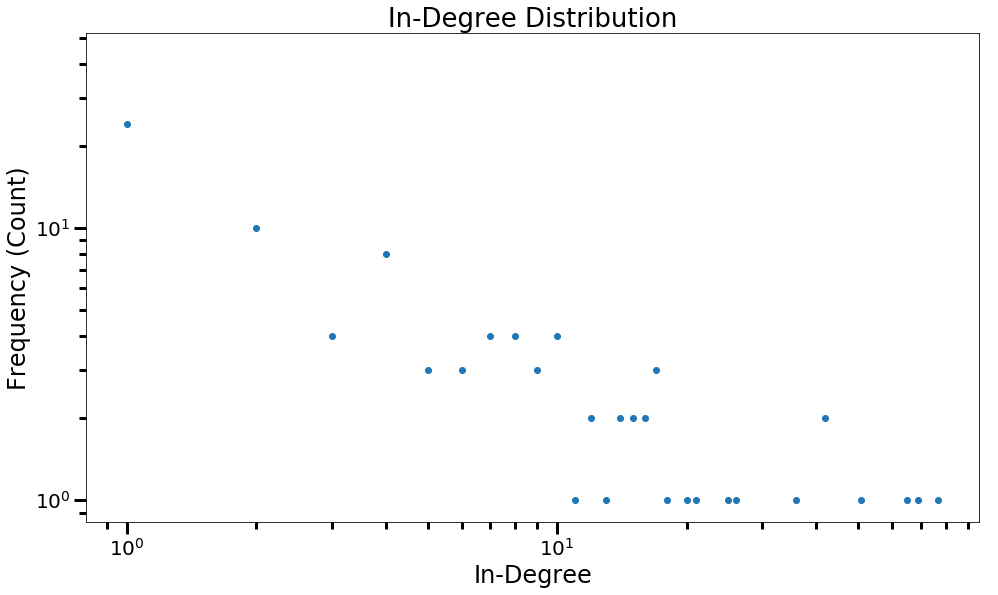

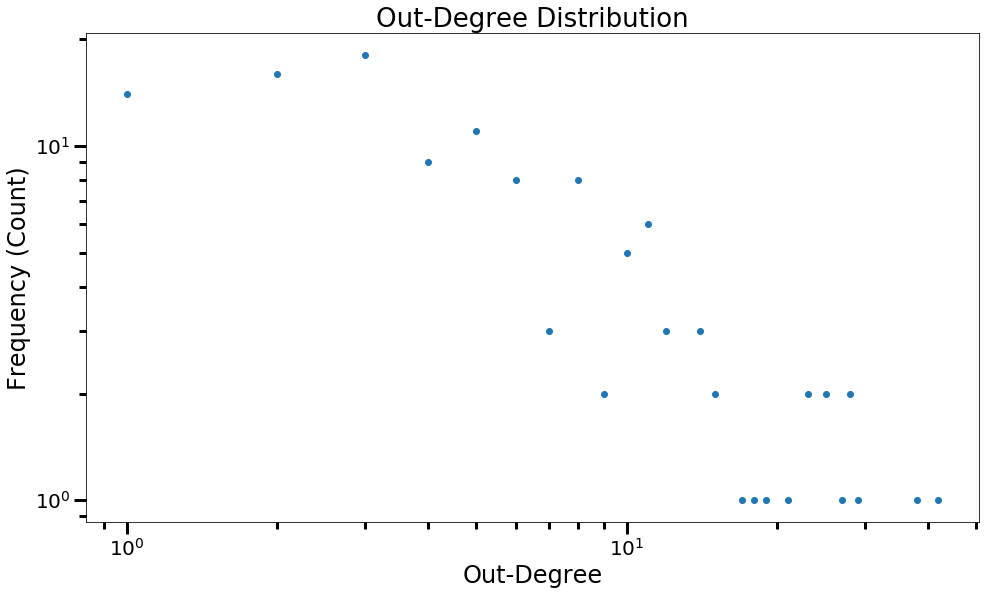

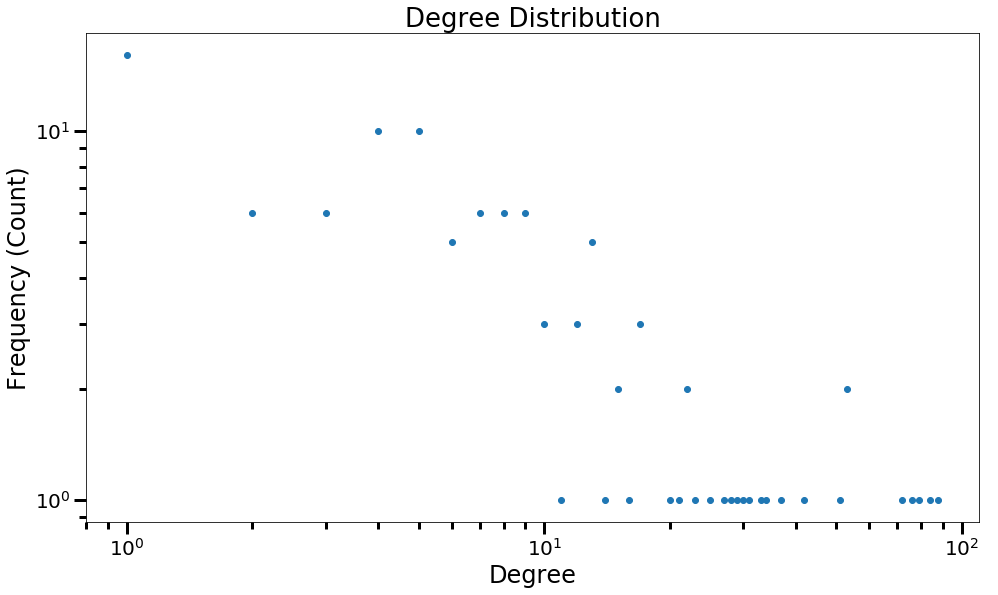

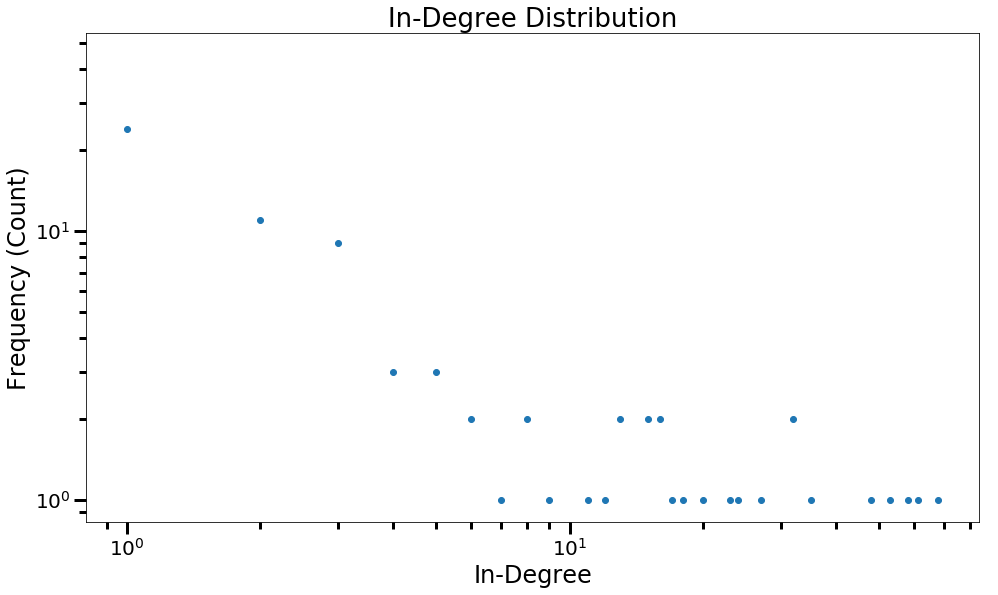

...

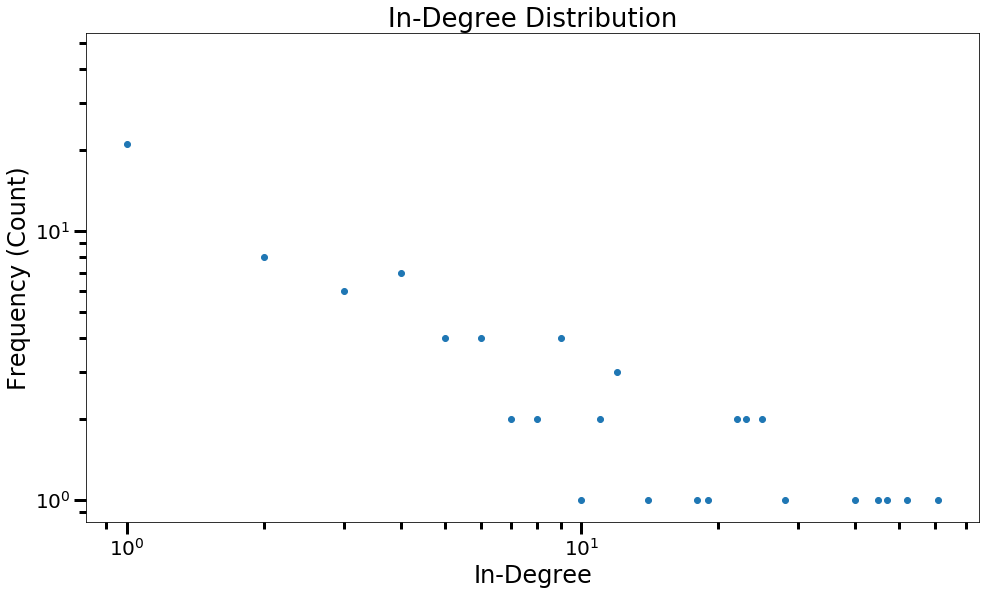

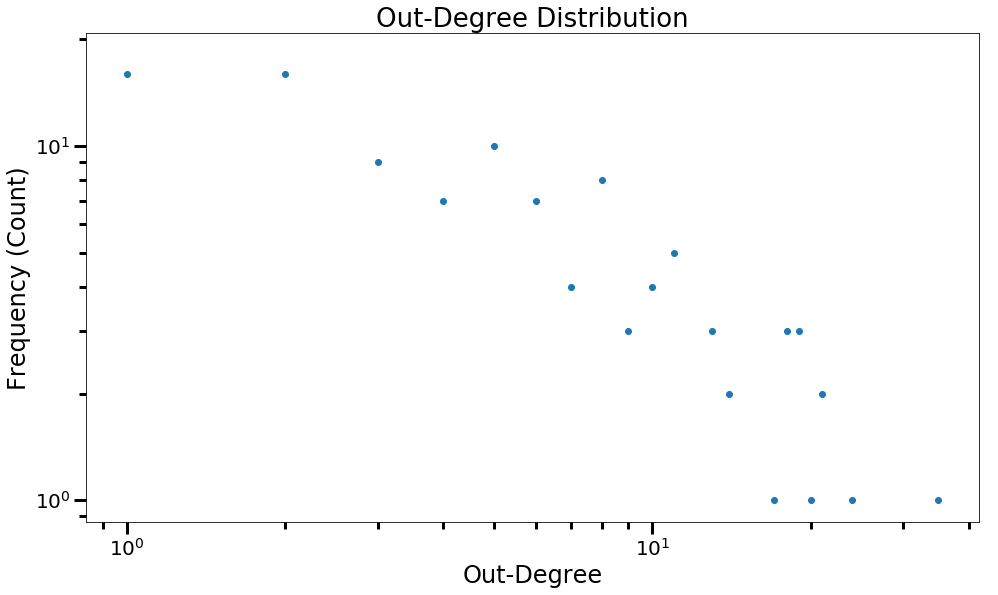

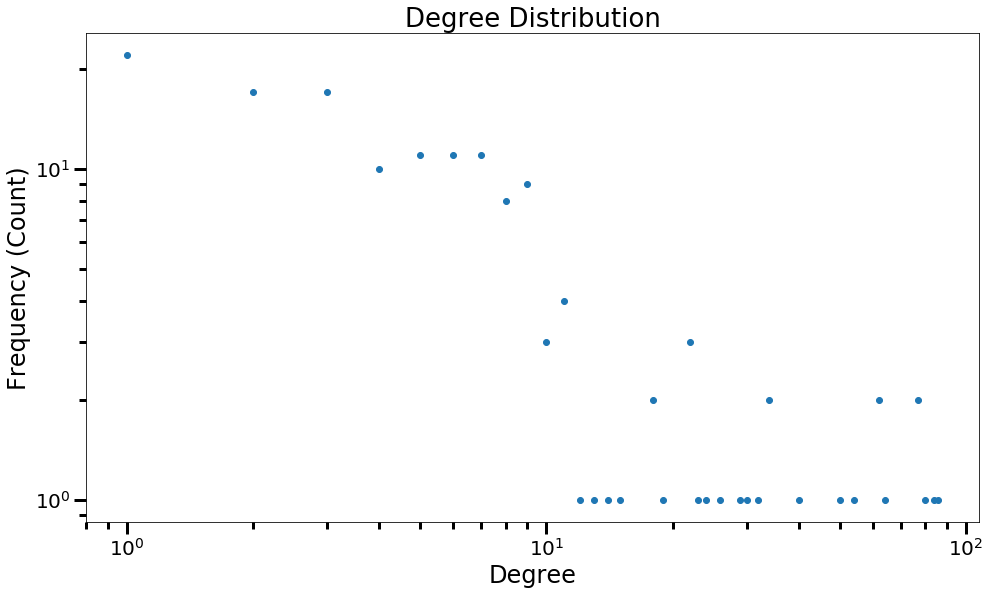

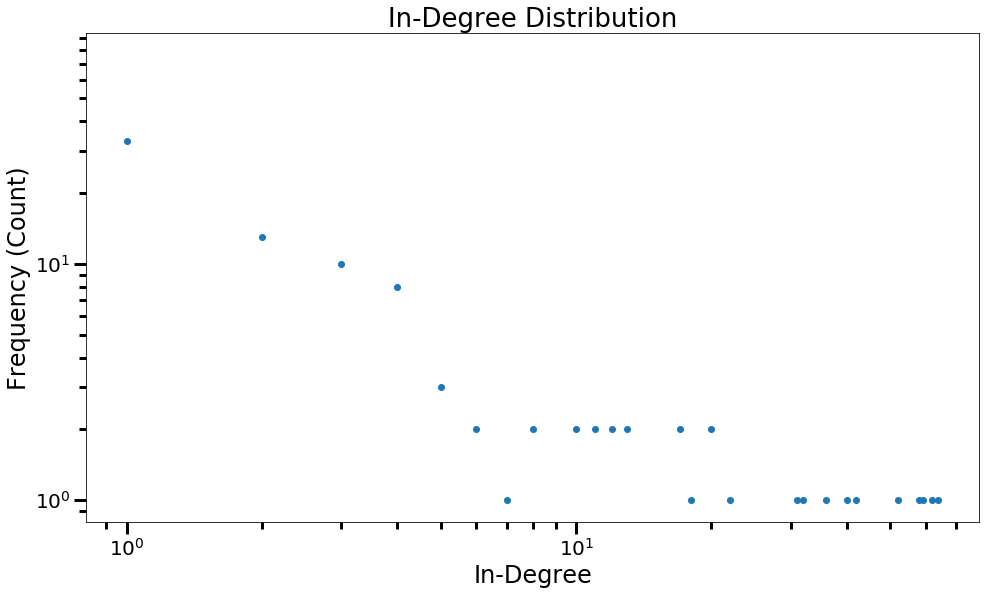

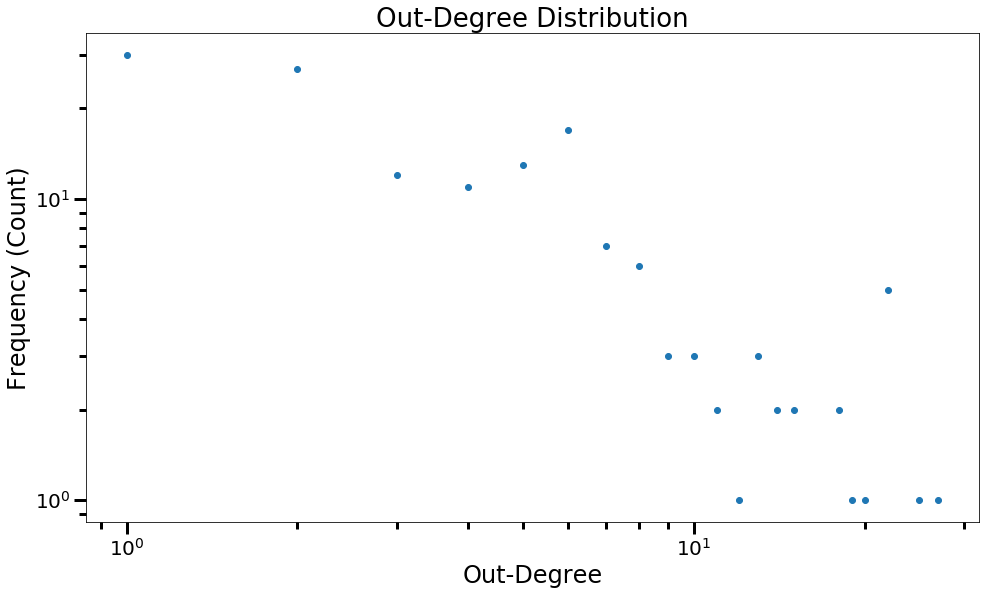

In [9]:
# Find out who the most connected characters are for each graph
for d in digraphs.keys():
    print "\n\n\n"
    print d
    DG = digraphs[d]["graph"]
    nodes = DG.nodes(data=True)
    nodes_2, degrees = zip(*DG.degree())
    
    # Calculate degree centrality
    deg_cent = nx.degree_centrality(DG)
    degree_centrality = [deg_cent[n] for n in nodes_2]
    
    # Calculate eigenvector centrality
    eig_cent = nx.eigenvector_centrality(DG)
    eigenvector_centrality = [eig_cent[n] for n in nodes_2]
    
    # Calculate betweenness centrality
    bet_cent = nx.betweenness_centrality(DG)
    betweenness_centrality = [bet_cent[n] for n in nodes_2]
    
    # Get In and Out node degrees
    in_deg = DG.in_degree()
    out_deg = DG.out_degree()
    in_degree = [in_deg[n] for n in nodes_2]
    out_degree = [out_deg[n] for n in nodes_2]
    
    df = pd.DataFrame(data=dict(name=nodes_2, degree=degrees, 
                                degree_centrality=degree_centrality,
                               eigenvector_centrality=eigenvector_centrality,
                               betweenness_centrality=betweenness_centrality,
                               in_degree=in_degree,
                               out_degree=out_degree))
    
    directory = os.path.join("Data", d.replace(" ", "_").replace(":",""))
    if not os.path.exists(directory):
        os.makedirs(directory)
    
    writer = pd.ExcelWriter(os.path.join(directory, "centrality.xlsx"), engine='xlsxwriter')
    df.to_excel(writer, sheet_name='Sheet1')
    
    # Display the top 10 connected characters based on the different metrics calculated above
    from IPython.display import display, HTML

    df = df.sort_values(by="degree", ascending=False)
    print "10 highest degree"
    display(HTML(df[["name", "degree"]][:10].to_html(index=False)))
    with open(os.path.join(directory, "top10_degree.txt"), 'w') as f:
        f.write(df[["name", "degree"]][:10].to_html(index=False).encode('utf-8'))
    
    df = df.sort_values(by="in_degree", ascending=False)
    print "10 highest in-degree"
    display(HTML(df[["name", "in_degree"]][:10].to_html(index=False)))
    with open(os.path.join(directory, "top10_in_degree.txt"), 'w') as f:
        f.write(df[["name", "in_degree"]][:10].to_html(index=False).encode('utf-8'))
    
    df = df.sort_values(by="out_degree", ascending=False)
    print "10 highest out-degree"
    display(HTML(df[["name", "out_degree"]][:10].to_html(index=False)))
    with open(os.path.join(directory, "top10_out_degree.txt"), 'w') as f:
        f.write(df[["name", "out_degree"]][:10].to_html(index=False).encode('utf-8'))

    df = df.sort_values(by="degree_centrality", ascending=False)
    print "10 highest degree centrality"
    display(HTML(df[["name", "degree_centrality"]][:10].to_html(index=False)))
    with open(os.path.join(directory, "top10_deg_cent.txt"), 'w') as f:
        f.write(df[["name", "degree_centrality"]][:10].to_html(index=False).encode('utf-8'))

    df = df.sort_values(by="eigenvector_centrality", ascending=False)
    print "10 highest eigenvector centrality"
    display(HTML(df[["name", "eigenvector_centrality"]][:10].to_html(index=False)))
    with open(os.path.join(directory, "top10_eig_cent.txt"), 'w') as f:
        f.write(df[["name", "eigenvector_centrality"]][:10].to_html(index=False).encode('utf-8'))
    
    df = df.sort_values(by="betweenness_centrality", ascending=False)
    print "10 highest betweenness_centrality"
    display(HTML(df[["name", "betweenness_centrality"]][:10].to_html(index=False)))
    with open(os.path.join(directory, "top10_betw_cent.txt"), 'w') as f:
        f.write(df[["name", "betweenness_centrality"]][:10].to_html(index=False).encode('utf-8'))
    
    
    # Calculate degree distributions
    degree = zip(*DG.degree())[1]
    in_degree = zip(*DG.in_degree())[1]
    out_degree = zip(*DG.out_degree())[1]


    bins = np.arange(min(degree), max(degree)+1)
    hist, bins = np.histogram(degree, bins=bins)

    plt.figure(figsize=(16,9))
    plt.loglog(bins[:-1], hist, 'o')
    plt.xlabel("Degree", fontsize=24)
    plt.ylabel("Frequency (Count)", fontsize=24)
    plt.title("Degree Distribution", fontsize=26)
    plt.tick_params(labelsize=20, length=12, width=3, which="major")
    plt.tick_params(length=7, width=3, which="minor")
    plt.savefig(os.path.join(directory, "degree_distribution.png"))


    in_bins = np.arange(min(in_degree), max(in_degree)+1)
    in_hist, in_bins = np.histogram(in_degree, bins=in_bins)

    plt.figure(figsize=(16,9))
    plt.loglog(in_bins[:-1], in_hist, 'o')
    plt.xlabel("In-Degree", fontsize=24)
    plt.ylabel("Frequency (Count)", fontsize=24)
    plt.title("In-Degree Distribution", fontsize=26)
    plt.tick_params(labelsize=20, length=12, width=3, which="major")
    plt.tick_params(length=7, width=3, which="minor")
    plt.savefig(os.path.join(directory, "in_degree_distribution.png"))


    out_bins = np.arange(min(out_degree), max(out_degree)+1)
    out_hist, out_bins = np.histogram(out_degree, bins=out_bins)

    plt.figure(figsize=(16,9))
    plt.loglog(out_bins[:-1], out_hist, 'o')
    plt.xlabel("Out-Degree", fontsize=24)
    plt.ylabel("Frequency (Count)", fontsize=24)
    plt.title("Out-Degree Distribution", fontsize=26)
    plt.tick_params(labelsize=20, length=12, width=3, which="major")
    plt.tick_params(length=7, width=3, which="minor")
    plt.savefig(os.path.join(directory, "out_degree_distribution.png"))
    
    # Save degree distributions to json
    degree_dist_json = {"data": {"In_Degree": {"bins": [float(x) for x in bins[:-1]], "hist": [float(x) for x in hist]},
                                 "Out_Degree": {"bins": [float(x) for x in out_bins[:-1]], "hist": [float(x) for x in out_hist]},
                                 "Degree": {"bins": [float(x) for x in in_bins[:-1]], "hist": [float(x) for x in in_hist]}}}

    with open(os.path.join(directory, "degree_distribution.json"), 'w') as f:
        json.dump(degree_dist_json, f)

Looking at all the tables that show the top 10 characters based on the different metrics that are described above, we can see that in most cases the top connected characters are those that play a central role in the storyline of the films. These are both the characters that have a lot of screen time, but also characters that see lower screen time but are never the less very important for the story as a whole. There are some exceptions to this. In a few cases we see other characters that have become some what of fan favorites. These characters do not neccissarily play a big role in anything. An example of that is *Sy Snootles* who appears in the top 10 characters in Episode VI based on betweenness centrality. She is the singer for The Max Rebo Band that played during the scene within Jabba's Palace.

## Community Detection

When the Wookieepedia pages were processed for links between characters the affiliations of each character were also collected. These affiliations were stored as node attributes when creating the networks. Lets take a look at the network for the entire universe, i.e. the single network that combines all the films and TV-series. Since the each character can have more than one affiliations it can make the creation of communities from them harder. Therefore only the first affiliation mentioned in each article is considered. We will visualize the networks and assign colors to the nodes depending on what affiliation they belong to. We will also calculate the optimal split into communities for the network and visualize it in the same way. For optimal split the Louvain algorithm[11] is used. For both community splits the modularity, $M$[1(section 9.4)], is calculated to identify which split has more pure communities. It would be optimal to make a confusion matrix to take a look at the communities that have formed, but since we have over 200 communities it would be impossible to visualize in a good way.

In [10]:
# Make a list of all the affiliations that are mentioned first in each article
DG = digraphs["all"]["graph"]
nodes = DG.nodes(data=True)
new_aff = defaultdict(dict)
for n in nodes:
    c = n[0]
    a = n[1]["data"]["affiliations"][0]
    new_aff[c]["affil"] = a

# Update node attributes with the single affiliation
nx.set_node_attributes(DG, new_aff)    

# Count the number of members associated with each affiliation
affiliations_count = defaultdict(int)
all_affiliations = []
nodes = DG.nodes(data=True)
# print nodes
for n in nodes:
    all_affiliations.append(n[1]["affil"])
    affiliations_count[n[1]["affil"]] += 1
    
all_affiliations = list(set(all_affiliations))

# Store the data in a pandas dataframe
affiliation_df = pd.DataFrame(data={"group": all_affiliations, "count": [affiliations_count[c] for c in all_affiliations]})
affiliation_df = affiliation_df[(affiliation_df["count"]>0)].sort_values(by="count", ascending=False)[["group", "count"]]

In [11]:
G = DG.to_undirected()
# Calculate the modularity coefficient of the partition that is based on affiliations
M = 0.0
L = float(len(G.edges()))
nodes = DG.nodes(data=True)
for com in affiliation_df["group"].values :
    list_nodes = [n[0] for n in nodes
                                if n[1]["affil"] == com]
    Lc = 0.0
    kc = 0.0
    for i in range(len(list_nodes)-1):
        character = list_nodes[i]
        kc += G.degree(character)
        for neighbor in G.neighbors(character):
            if neighbor in list_nodes[i+1:]:
                Lc += 1.0
    M += ((Lc/L) - np.power((kc/(2*L)), 2))
    
print("The modularity of the community partition based on affiliation is: M={0}".format(M))

The modularity of the community partition based on affiliation is: M=0.152824804758


In [12]:
# Find the best community partition

G = DG.to_undirected()
partition = community.best_partition(G)
# Calculate the modularity coefficient of this optimal partition
M = 0.0
L = float(len(G.edges()))

com_size = defaultdict(int)

for com in set(partition.values()) :
    list_nodes = [nodes for nodes in partition.keys()
                                if partition[nodes] == com]
    Lc = 0.0
    kc = 0.0
    for i in range(len(list_nodes)-1):
        character = list_nodes[i]
        kc += G.degree(character)
        for neighbor in G.neighbors(character):
            if neighbor in list_nodes[i+1:]:
                Lc += 1.0
    M += ((Lc/L) - np.power((kc/(2*L)), 2))
    
print("The modularity of the optimal community partition is: M={0}".format(M))

# Calculate the sizes of the optimal communities and store results in a dataframe
for com in partition.values():
    com_size[com] += 1

df_community_size = pd.DataFrame(data={"com":com_size.keys(), "count":[com_size[x] for x in com_size.keys()]})

df_community_size = df_community_size[["com", "count"]].sort_values(by="count", ascending=False)

The modularity of the optimal community partition is: M=0.505782875317


Optimal communities


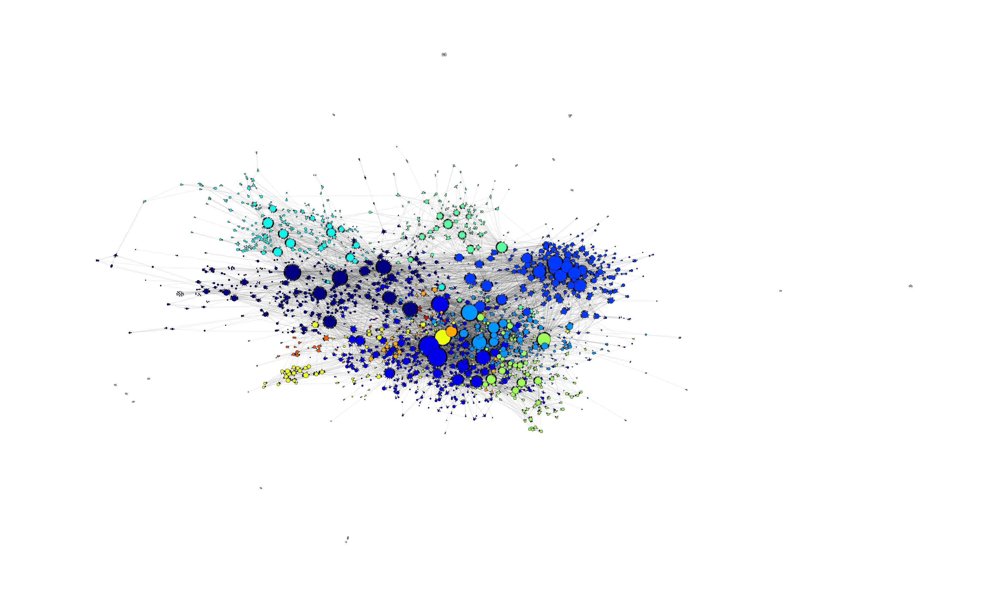

In [13]:
# Read the json file that contains data for graph regeneration
with open(os.path.join("Data", "movie_networks.json"), 'r') as f:
    starwars_networks = json.load(f)


nodes = DG.nodes(data=True)
nodes_2, degrees = zip(*DG.degree())

# node size proportional to the degree
node_sizes_deg = [10*x for x in degrees]

# # Color according to the party
node_colors = [partition[n] for n in nodes_2]
# print node_colors
cmap = plt.get_cmap("jet")
max_partition = float(max(node_colors))
biggest_coms = list(df_community_size[df_community_size["count"]>9]["com"].values)
node_colors = [cmap(biggest_coms.index(col)/float(len(biggest_coms))) if col in biggest_coms else (1.0, 1.0, 1.0, 1.0) for col in node_colors]
# print node_colors
# nx.draw(DG, positions, node_color=node_colors, node_size=node_sizes_deg, with_labels=False, edgecolors="white", edge_color='k', width=0.1)

plt.figure(figsize=(50,30))
print "Optimal communities"
nx.draw(DG, starwars_networks["all"]["node_pos"], node_color=node_colors, node_size=node_sizes_deg, with_labels=False, edgecolors="k", edge_color='k', width=0.1)
#     plt.title(dig)




directory = os.path.join("Data", "all")
if not os.path.exists(directory):
    os.makedirs(directory)
plt.savefig(os.path.join(directory, "network_optimal_partitions.png"))

Communities based on affiliations


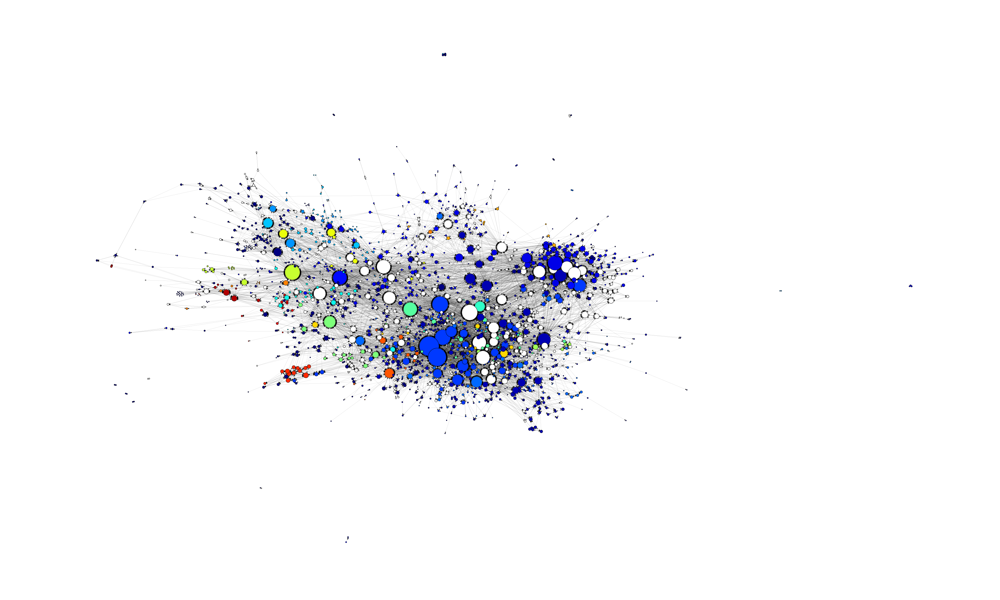

In [14]:
nodes = DG.nodes(data=True)
nodes_2, degrees = zip(*DG.degree())

# node size proportional to the degree
node_sizes_deg = [10*x for x in degrees]

# # Color according to the party
possible_affiliations = affiliation_df[(affiliation_df["count"]>9)]
temp = dict(DG.nodes(data=True))

node_colors = [temp[n]["affil"] for n in nodes_2]
# print node_colors
cmap = plt.get_cmap("jet")
biggest_coms = list(possible_affiliations["group"].values)
node_colors = [cmap(biggest_coms.index(col)/float(len(biggest_coms))) if col in biggest_coms else (1.0, 1.0, 1.0, 1.0) for col in node_colors]
# print node_colors
# nx.draw(DG, positions, node_color=node_colors, node_size=node_sizes_deg, with_labels=False, edgecolors="white", edge_color='k', width=0.1)

plt.figure(figsize=(50,30))
print "Communities based on affiliations"
nx.draw(DG, starwars_networks["all"]["node_pos"], node_color=node_colors, node_size=node_sizes_deg, with_labels=False, edgecolors="k", edge_color='k', width=0.1)
#     plt.title(dig)

directory = os.path.join("Data", "all")
if not os.path.exists(directory):
    os.makedirs(directory)
plt.savefig(os.path.join(directory, "network_affiliation_partitions.png"))

Lets start by looking at the modularity, $M$, of the two different community splits. The modularities are:
+ Communities based on affiliation: $M = 0.15$
+ Optimal community split: $M = 0.51$

We can see that since M>0.0 for both splits either one of them could be used as communities. The communities that are based on affiliations are not optimal because the modularity is not high enough. The optimal split creates better communities because it has a considerably higher modularity coefficient.

The same conclusion can be drawn from looking at the visualization of the two different splits. The optimal community visualization shows that the communities are very well grouped together with only a small overlap between some of the communities. This is not the case for the affiliation visualization. There the communiteis are more irratic. They are not as well grouped together as the optimal communities are and the overlap between different communities is much larger.

Note that because of the high number of different communities it was not possible to assign a color to each one of them. Every community that has 10 or more members have their own colors, but the other communities that have 9 or less members are all displayed as white nodes.

## Character Sentiment

The sentiment of a text tells us something about how happy/unhappy or positive/negative the contents of the text is. We calculate the sentiment in a text using the Hedonometer algorithm[12]. To get the happyness of words Data Set 1 from the same article is used. The happiness of a text, $T$, is calculated as:
$h_{avg}(T)\sum_{i=0}^N h_{avg}(w_i)p_i$
where $p_i$ is the normalized frequency of word $w_i$ and $h_{avg}(w_i)$ is the average happiness of word $w_i$.

Lets find the top 5 and bottom 5 characters based on the sentiment calculated using their Wookieepedia pages. Do the results make any sense based on my knowledge of the Star Wars universe?

Before the sentiment can be calculated the texts need to be tokenized. That is done with the use of regular expressions[13] and then filtering some specific words out afterwards. The regular expression used is:
```python
     r'''(?x)    # set flag to allow verbose regexps
        (?:[A-Z]\.)+        # abbreviations, e.g. U.S.A.
        | [A-Za-z]\w*(?:-\w+)*  # words with optional internal hyphens
      '''
```
The regular extressions matcehs abbreviations wiht all capital letters and more general words that start with a letter. After the initial letter there can be either more letters or alphanumberic digits. This filters out every numbers so we don't have to do that in a loop later on. After tokenization we filter out all of the stopwords in the text using the list of stopwords in the NLTK[14] python library. Using the list of tokens/words the sentiment can easily be calculated. Instead of considering all of the 1945 characters we only consider the top 50 important characters based on degree centrality. We do this since the most important characters tend to have more detailed Wookieepedia pages and are therefore a better source to analyze for sentiment.

In [15]:
# ADD SENTIMENT TO THE JSON
dataframes = []
char_sentiment = defaultdict(dict)
chars = list(set(starwars_json["data"]["characters"].keys()).difference(set(starwars_json["failed"]["characters"].keys()).union(exclude_from_nodes)))
for i in range(len(chars)):
    c = chars[i]
    text = starwars_json["data"]["characters"][c]["wikicontent"]
    tokens = []

    # Only detect words and abbreviations, not numbers or punctuations
    pattern = r'''(?x)    # set flag to allow verbose regexps
        (?:[A-Z]\.)+        # abbreviations, e.g. U.S.A.
      | [A-Za-z]\w*(?:-\w+)*  # words with optional internal hyphens
      '''
    stopw = stopwords.words('english')
    other_words = []
    # Tokenize the text with regex
    tokens = nltk.regexp_tokenize(text, pattern)
    # Exclude twitter handles and stopwords from the list of tokens and set the token to lowercase
    tokens = [t.lower() for t in tokens if ((t.lower() not in stopw) and (t.lower() not in other_words))]

    # Create a dataframe from the tokens and calculate sentiment
    df_tokens = pd.DataFrame(data=dict(word=tokens))
    dataframes.append(df_tokens)
    char_sentiment[c]["tokens"] = df_tokens
    char_sentiment[c]["sentiment"] = evaluate_sentiment(tokens)

In [16]:
DG = digraphs["all"]["graph"]
nodes = DG.nodes(data=True)
nodes_2, degrees = zip(*DG.degree())

deg_cent = nx.degree_centrality(DG)
degree_centrality = [deg_cent[n] for n in nodes_2]

eig_cent = nx.eigenvector_centrality(DG)
eigenvector_centrality = [eig_cent[n] for n in nodes_2]

df = pd.DataFrame(data=dict(name=nodes_2, degree=degrees, 
                            degree_centrality=degree_centrality,
                           eigenvector_centrality=eigenvector_centrality))

df = df.sort_values(by="degree_centrality", ascending=False)
sentiment_list = []
for n in df["name"].values:
    sentiment_list.append(char_sentiment[n]["sentiment"])
df["sentiment"] = sentiment_list

print "Top 5 characters based on sentiment"
print df[["name", "sentiment"]][:50].sort_values(by="sentiment", ascending=False)[:5]

print "Bottom 5 characters based on sentiment"
print df[["name", "sentiment"]][:50].sort_values(by="sentiment", ascending=False)[-5:]

Top 5 characters based on sentiment
                name  sentiment
508              Rey   3.570262
1806      Mon Mothma   3.568786
368         Han Solo   3.568666
1015        Jyn Erso   3.526286
708   Luke Skywalker   3.451366
Bottom 5 characters based on sentiment
             name  sentiment
507           Rex   2.938937
1458        Dooku   2.920759
1228  Nute Gunray   2.900431
753    Jango Fett   2.837361
1185     Cad Bane   2.799329


Looking at the top 5 happiest/most positive characters we notice they all belong to factions that are aligned with the light side of the force, i.e. they are the good guys. The opposite is true for the 5 most unhappy/negative. They are characters that are considered as the bad guys, except for Rex. Rex was a clone captain in the 501st legion. Perhaps he appears as negative since all of his appearances have been related to the Clone Wars, a time of conflict that most likely affects the contents of his Wookieepedia page.

## What words characterize the films/TV-series?

Can the most used words in the scripts of each film/TV-series tell us something? Do they in someway describe the plot of the film? To figure that out we can use Word Clouds[8] to display the most used words. To find the most used words we have to tokenize the scripts first. We use the same mehtod as we used to tokenize the character pages described above. From the list of words for each film/TV-series we can use a method called TF-IDF[15] (Term Freqeucny - Inverse Document Frequency) where we consider each film/TV-series as a document. The TF-IDF score tells us something about have often a word is used. More than that it also takes into account in how many of the documents it is used in and assigns high score to words that are used often, but in few documents.

In [17]:
#Read the scripts json
with open("starwars_transcripts_springfield.json", 'r') as f:
    transcript_json = json.load(f)


# Define a list of movies and series and order them by time
movies = ["Star Wars: Episode I The Phantom Menice", "Star Wars: Episode II Attack of the Clones",
        "Star Wars: The Clone Wars (film)", "Star Wars: Episode III Revenge of the Sith",
        "Solo: A Star Wars Story", "Rogue One: A Star Wars Story", "Star Wars: Episode IV A New Hope",
        "Star Wars: Episode V The Empire Strikes Back", "Star Wars: Episode VI Return of the Jedi",
        "Star Wars: Episode VII The Force Awakens", "Star Wars: Episode VIII The Last Jedi"]

animated_series_names = ["Star Wars: The Clone Wars (series)", "Star Wars Rebels"]

media_in_time_order = [("movies", "Star Wars: Episode I The Phantom Menice"), ("movies", "Star Wars: Episode II Attack of the Clones"),
                       ("movies", "Star Wars: The Clone Wars (film)"),
                       ("series", "Star Wars: The Clone Wars (series)"),
                       ("movies", "Star Wars: Episode III Revenge of the Sith"),
                       ("movies", "Solo: A Star Wars Story"), 
                       ("series", "Star Wars Rebels"),
                       ("movies", "Rogue One: A Star Wars Story"), ("movies", "Star Wars: Episode IV A New Hope"),
                       ("movies", "Star Wars: Episode V The Empire Strikes Back"), ("movies", "Star Wars: Episode VI Return of the Jedi"),
                       ("movies", "Star Wars: Episode VII The Force Awakens"), ("movies", "Star Wars: Episode VIII The Last Jedi")]

In [18]:
# Tokenize all the transcripts
transcript_tokens = defaultdict(dict)
dataframes = []
for m in movies:
    script = transcript_json["data"]["movies"][m]["transcript"]
    
    tokens = []

    # Only detect words and abbreviations, not numbers or punctuations
    pattern = r'''(?x)    # set flag to allow verbose regexps
        (?:[A-Z]\.)+        # abbreviations, e.g. U.S.A.
      | [A-Za-z]\w*(?:-\w+)*  # words with optional internal hyphens
      '''
    stopw = stopwords.words('english')
    other_words = []
    # Tokenize the text with regex
    tokens = nltk.regexp_tokenize(script, pattern)
    # Exclude twitter handles and stopwords from the list of tokens and set the token to lowercase
    tokens = [t.lower() for t in tokens if ((t.lower() not in stopw) and (t.lower() not in other_words))]

    df_tokens = pd.DataFrame(data=dict(word=tokens))
    dataframes.append(df_tokens)
    transcript_tokens[m]["tokens"] = df_tokens
    transcript_tokens[m]["sentiment"] = evaluate_sentiment(tokens)

for s in animated_series_names:
    all_tokens = []
    for e in transcript_json["data"]["series"][s]:
        script = transcript_json["data"]["series"][s][e]["transcript"]
        enumber = transcript_json["data"]["series"][s][e]["episode"]
        
        tokens = []

        # Only detect words and abbreviations, not numbers or punctuations
        pattern = r'''(?x)    # set flag to allow verbose regexps
            (?:[A-Z]\.)+        # abbreviations, e.g. U.S.A.
          | [A-Za-z]\w*(?:-\w+)*  # words with optional internal hyphens
          '''
        stopw = stopwords.words('english')
        other_words = []
        # Tokenize the text with regex
        tokens = nltk.regexp_tokenize(script, pattern)
        # Exclude twitter handles and stopwords from the list of tokens and set the token to lowercase
        tokens = [t.lower() for t in tokens if ((t.lower() not in stopw) and (t.lower() not in other_words))]

        df_tokens = pd.DataFrame(data=dict(word=tokens))
#         dataframes.append(df_tokens)
        all_tokens.extend(tokens)
        transcript_tokens[s][e] = {"tokens": df_tokens, "episode": enumber, "sentiment": evaluate_sentiment(tokens)}
        
    df_all_tokens = pd.DataFrame(data=dict(word=all_tokens))
    dataframes.append(df_all_tokens)
    transcript_tokens[s]["all_tokens"] = df_all_tokens


# Calculate TF-IDF for each movie
tfidf_dataframes = TFIDF(dataframes)
for i in range(len(movies)):
    transcript_tokens[movies[i]]["TFIDF"] = tfidf_dataframes[i]

j = i+1
# Calculate TF-IDF for each TV-series
for x in animated_series_names:
    transcript_tokens[x]["TFIDF"] = tfidf_dataframes[j]
    j += 1
#     for e in transcript_json["data"]["series"][s]:
#         transcript_tokens[s][e]["TFIDF"] = tfidf_dataframes[j]
#         j += 1

Star Wars: Episode I The Phantom Menice


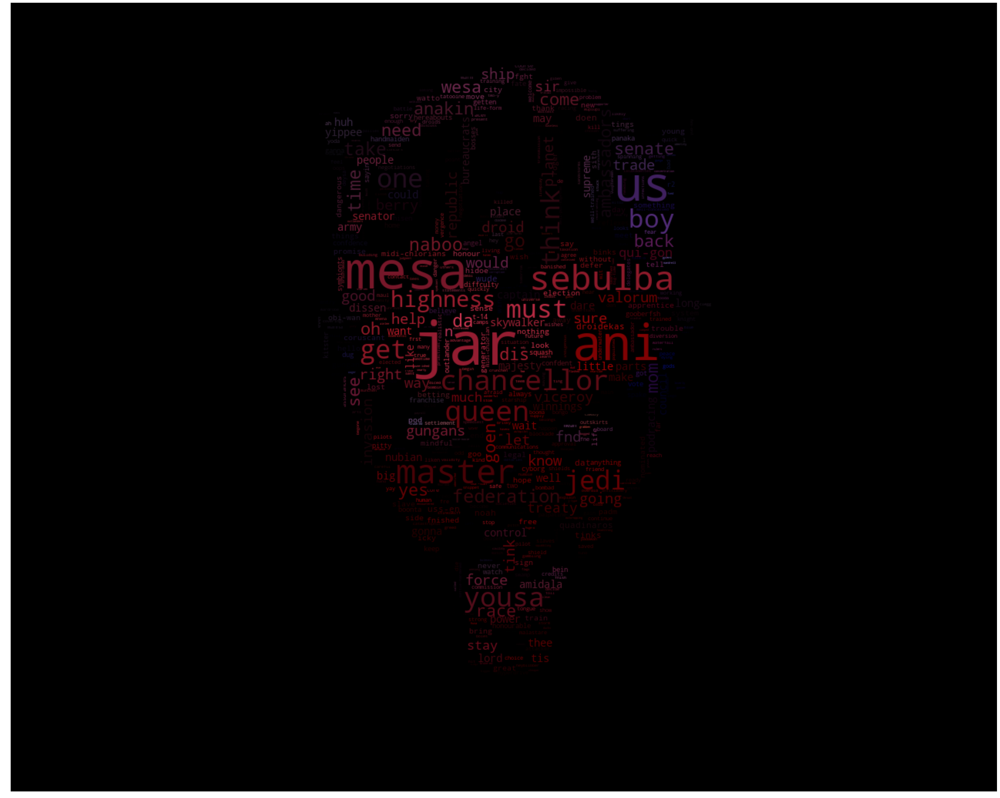

Star Wars: Episode II Attack of the Clones


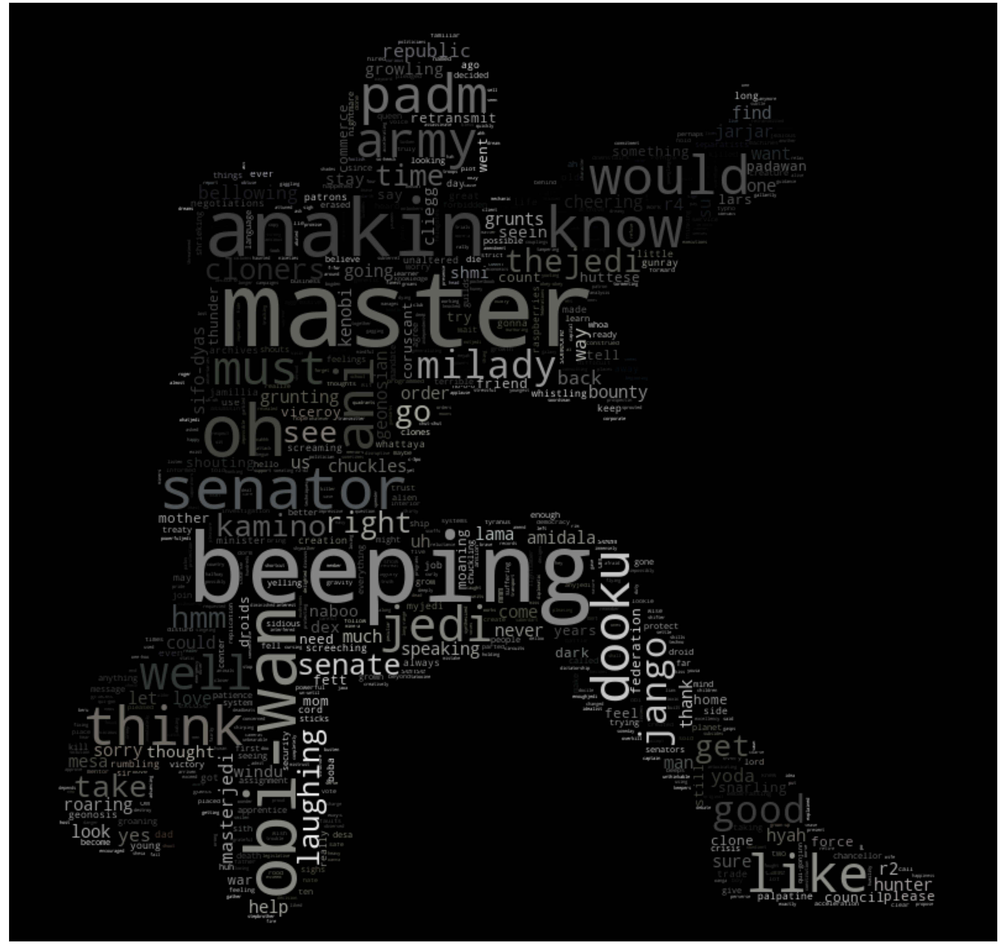

Star Wars: The Clone Wars (film)


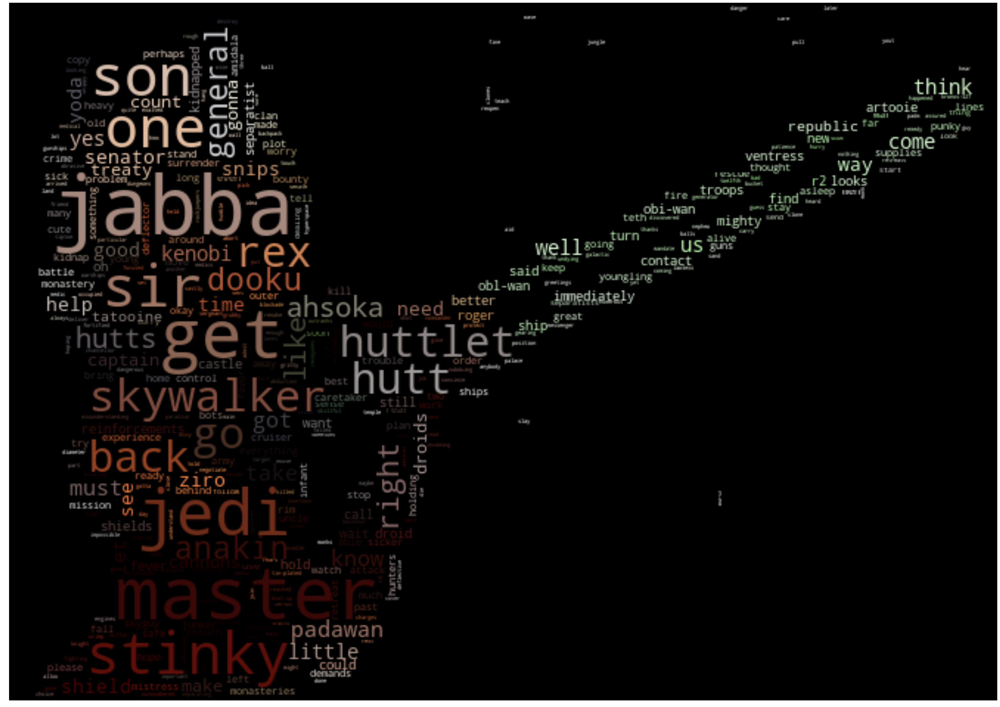

Star Wars: Episode III Revenge of the Sith


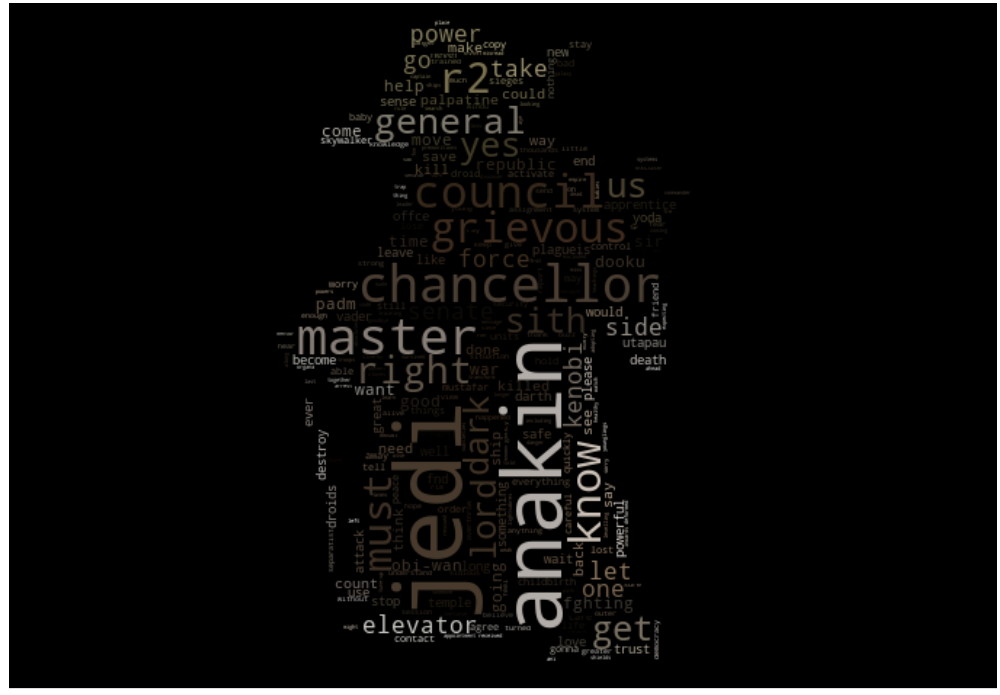

Solo: A Star Wars Story


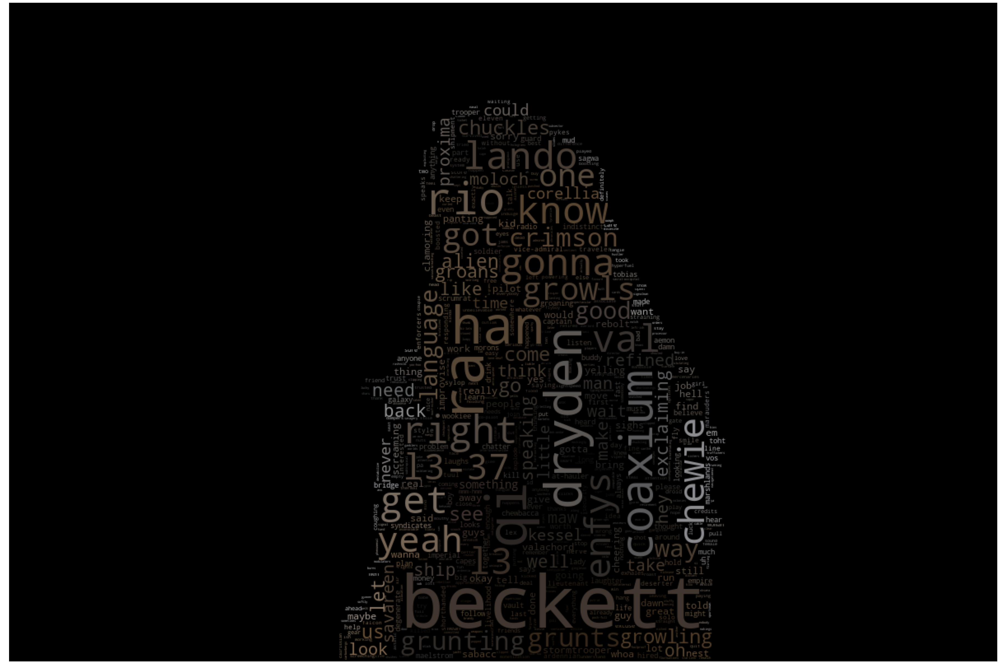

Rogue One: A Star Wars Story


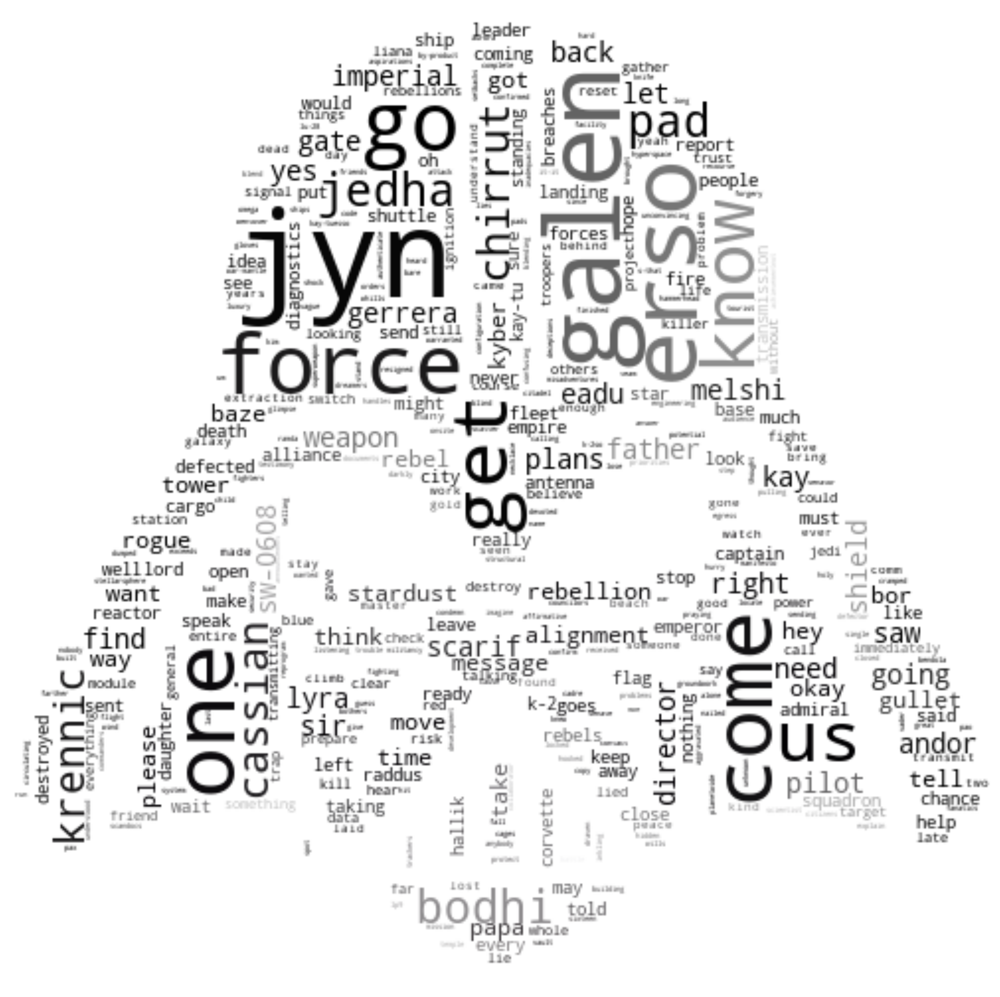

Star Wars: Episode IV A New Hope


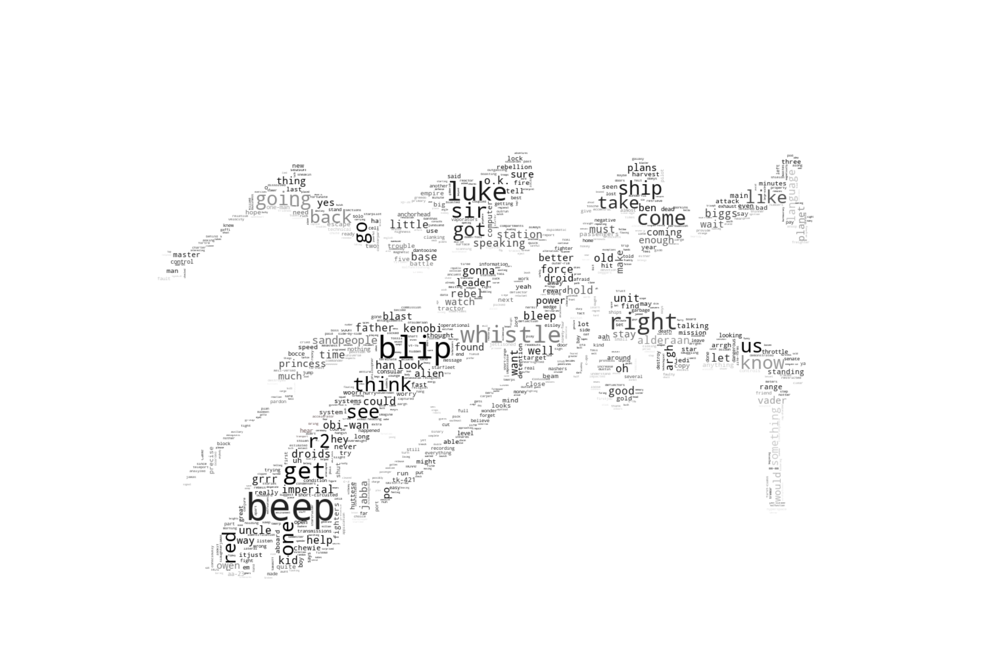

Star Wars: Episode V The Empire Strikes Back


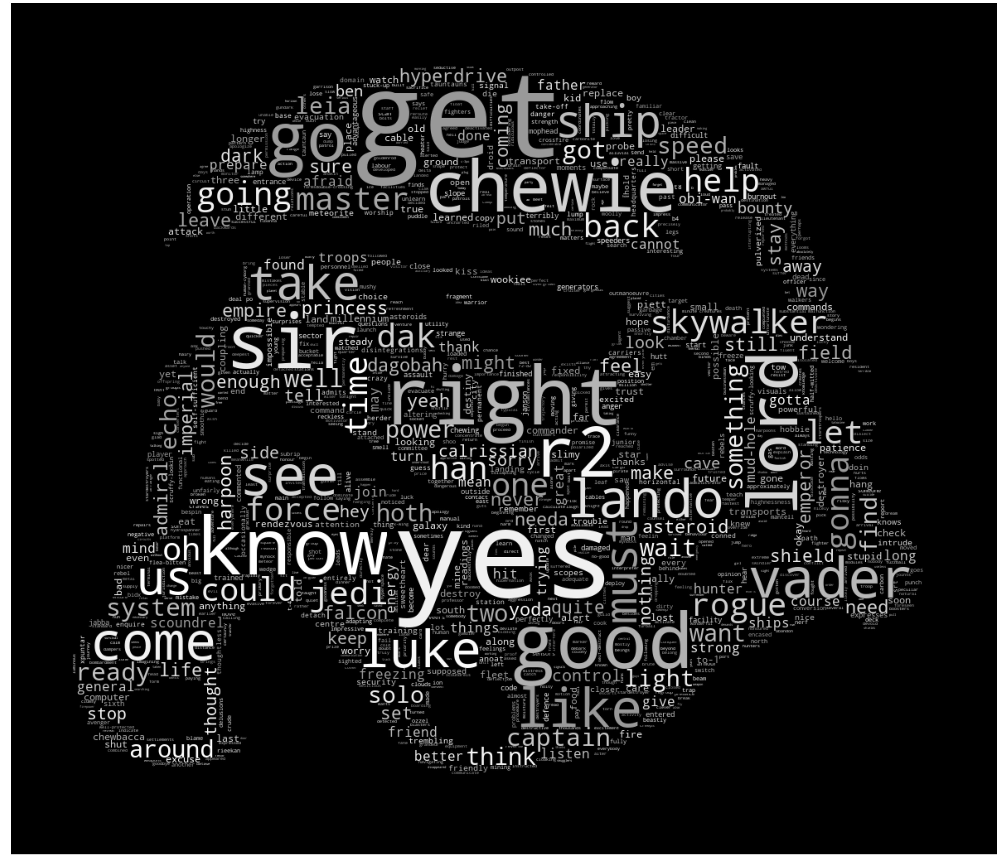

Star Wars: Episode VI Return of the Jedi


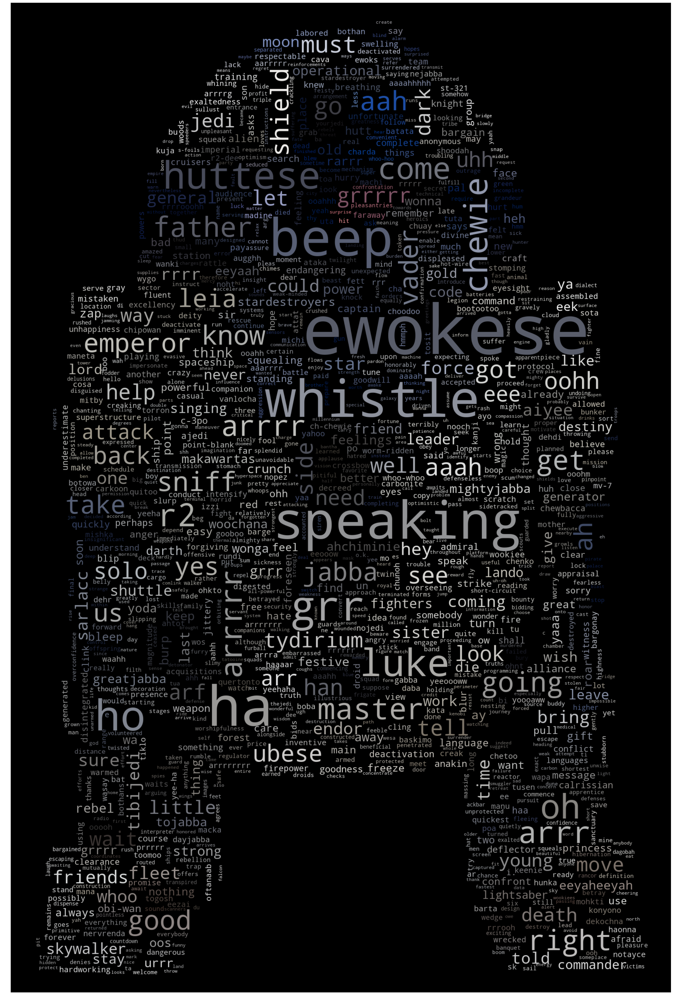

Star Wars: Episode VII The Force Awakens


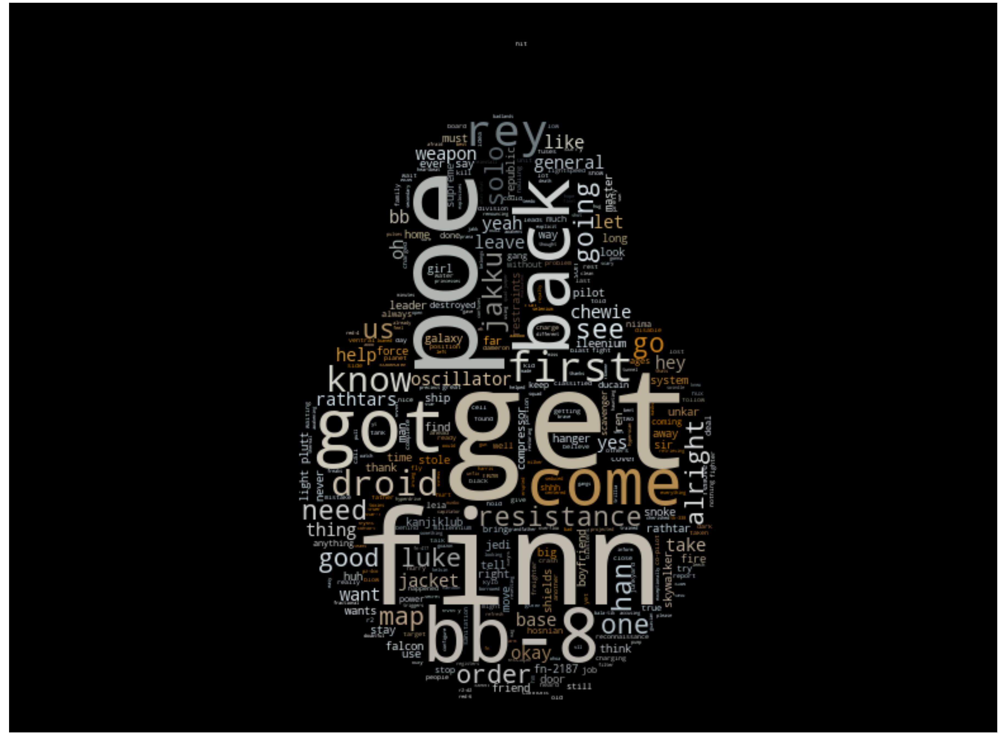

Star Wars: Episode VIII The Last Jedi


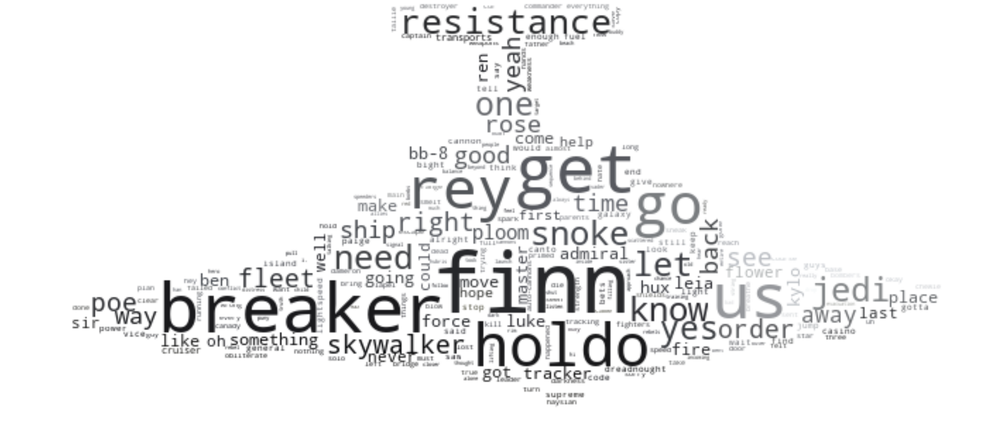

Star Wars: The Clone Wars (series)


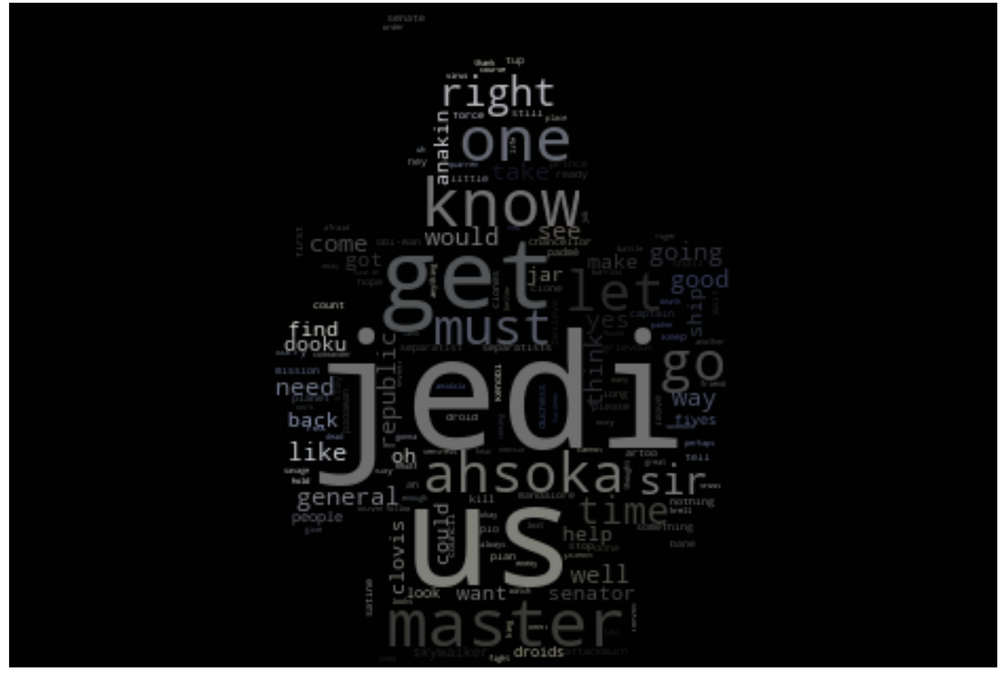

Star Wars Rebels


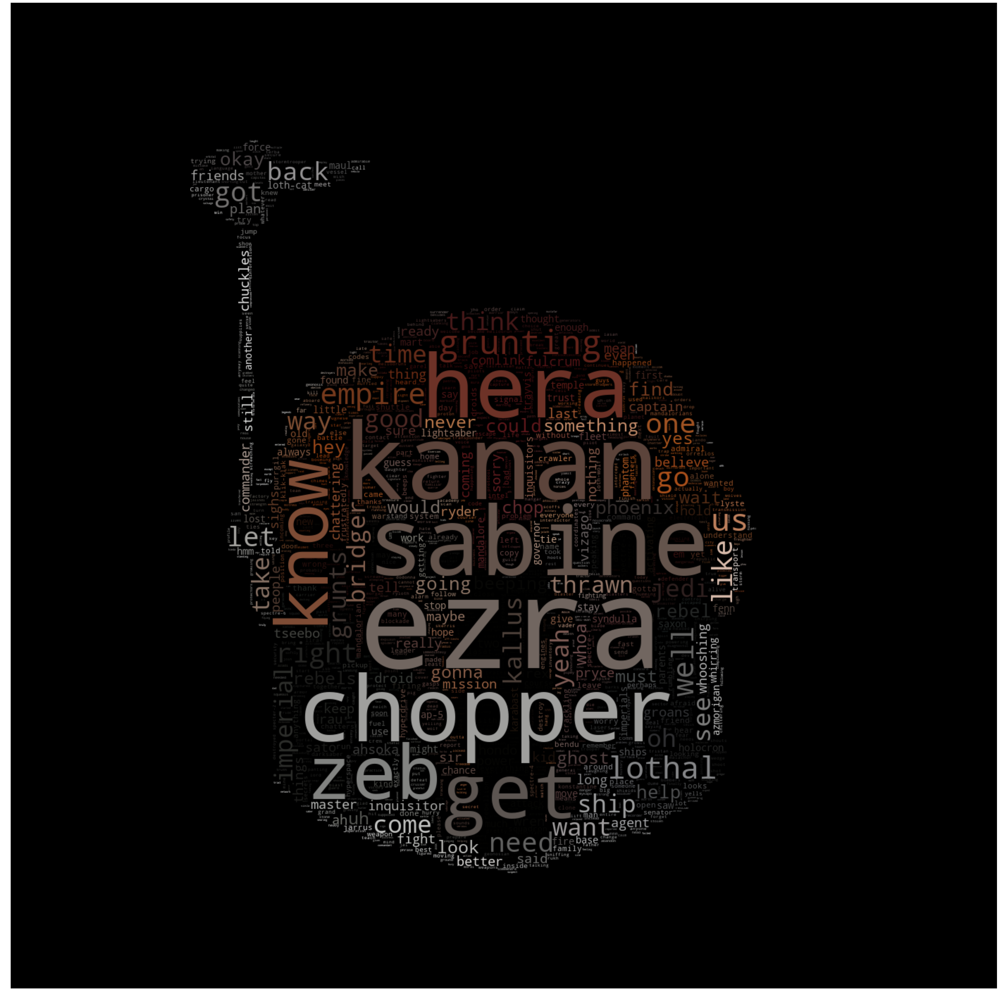

In [19]:
# Make Word Clouds with masks to make them look like Star Wars
def grey_color_func(word, font_size, position, orientation, random_state=None,
                    **kwargs):
    return "hsl(0, 0%%, %d%%)" % random.randint(60, 100)

masks = ["Data/WordCloudMasks/maul_mask.jpg", "Data/WordCloudMasks/clone_trooper_mask.jpg", "Data/WordCloudMasks/ahsoka3.jpg",
        "Data/WordCloudMasks/yoda_mask2.jpg", "Data/WordCloudMasks/chewy_mask.jpg", "Data/WordCloudMasks/darth_vader2.jpg",
        "Data/WordCloudMasks/xwing.jpg", "Data/WordCloudMasks/stormtrooper_mask.png", "Data/WordCloudMasks/R2D2_mask.jpg",
        "Data/WordCloudMasks/bb8_mask.jpg", "Data/WordCloudMasks/star_destroyer_mask.jpg"]
coloring = ["Data/WordCloudMasks/maul_colors.jpg", "Data/WordCloudMasks/clone_trooper.jpg", "Data/WordCloudMasks/ahsoka3.jpg",
           "Data/WordCloudMasks/yoda_mask2.jpg", "Data/WordCloudMasks/chewy.jpg", "Data/WordCloudMasks/darth_vader2.jpg",
           "Data/WordCloudMasks/xwing.jpg", None, "Data/WordCloudMasks/R2D2.png", "Data/WordCloudMasks/bb8.jpg",
           "Data/WordCloudMasks/star_destroyer.jpg"]
backgrounds = ["black", "black", "black", "black", "black", "white", "white", "black", "black", "black", "white"]
i = 0
# Make Word Clouds based on TF-IDF for each movie
for m in movies:
    print m
    df_tfidf = transcript_tokens[m]["TFIDF"]
    df_tfidf.index = df_tfidf.word
    df_tfidf.TFIDF = np.ceil(df_tfidf.TFIDF.values)
    mask = np.array(Image.open(masks[i]))
    if coloring[i] is not None:
        image_colors = ImageColorGenerator(np.array(Image.open(coloring[i])))
    wc = WordCloud(background_color=backgrounds[i], max_words=2000, mask=mask, stopwords=STOPWORDS).generate_from_frequencies(df_tfidf["TFIDF"].to_dict())

    # show
    fig = plt.figure(figsize=(50,50), frameon=False)
    ax = plt.Axes(fig, [0., 0., 1., 1.], )
    ax.set_axis_off()
    fig.add_axes(ax)
    
    directory = os.path.join("Data", m.replace(" ", "_").replace(":",""))
    if not os.path.exists(directory):
        os.makedirs(directory)
    
    if coloring[i] is not None:
        plt.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
        plt.imsave(os.path.join(directory, "wordcloud.png"), wc.recolor(color_func=image_colors))
    else:
        plt.imshow(wc.recolor(color_func=grey_color_func), interpolation="bilinear")
        plt.imsave(os.path.join(directory, "wordcloud.png"), wc.recolor(color_func=grey_color_func))
    
    plt.show()
    i+=1

    
masks = ["Data/WordCloudMasks/cpt_rex_mask.jpg", "Data/WordCloudMasks/sabine2.jpg"]
coloring = ["Data/WordCloudMasks/cpt_rex.jpg", "Data/WordCloudMasks/sabine2.jpg"]
i = 0

# Make Word Clouds based on TF-IDF for each TV-series
for s in animated_series_names:
    print s
    df_tfidf = transcript_tokens[s]["TFIDF"]
    df_tfidf.index = df_tfidf.word
    df_tfidf.TFIDF = np.ceil(df_tfidf.TFIDF.values)
    mask = np.array(Image.open(masks[i]))
    if coloring[i] is not None:
        image_colors = ImageColorGenerator(np.array(Image.open(coloring[i])))
    wc = WordCloud(background_color=backgrounds[i], max_words=2000, mask=mask, stopwords=STOPWORDS).generate_from_frequencies(df_tfidf["TFIDF"].to_dict())

    fig = plt.figure(figsize=(50,50), frameon=False)
    ax = plt.Axes(fig, [0., 0., 1., 1.], )
    ax.set_axis_off()
    fig.add_axes(ax)
    
    directory = os.path.join("Data", s.replace(" ", "_").replace(":",""))
    if not os.path.exists(directory):
        os.makedirs(directory)
    
    if coloring[i] is not None:
        plt.imshow(wc.recolor(color_func=image_colors), interpolation="bilinear")
        plt.imsave(os.path.join(directory, "wordcloud.png"), wc.recolor(color_func=image_colors))
    else:
        plt.imshow(wc.recolor(color_func=grey_color_func), interpolation="bilinear")
        plt.imsave(os.path.join(directory, "wordcloud.png"), wc.recolor(color_func=grey_color_func))

    plt.show()
    i+=1

The words that appear in the Word Clouds above are those that are the most used in each move according to TF-IDF. The words that are the biggest are those that are most important. Looking over the Word Clouds we see that among the most important words are the names of the characters that are important to the story lines of each movie. We also see words that can be related to the story lines of the movies. As an example in the Word Cloud for *Episode I - The Phantom Menice* we see worrds like ambassadors, gungans, naboo, chancellor, federation and boy, all of which relate closely to the story that is told in the movie.

## Sentiment timeline

Using sentiment analysis we can create a timeline of how the sentiment in the Star Wars galaxy evolves over time. To calculate sentiment we use the same method as we did when analyzing sentiment of characters. Can we relate the changes in sentiment to what happens in the movies?

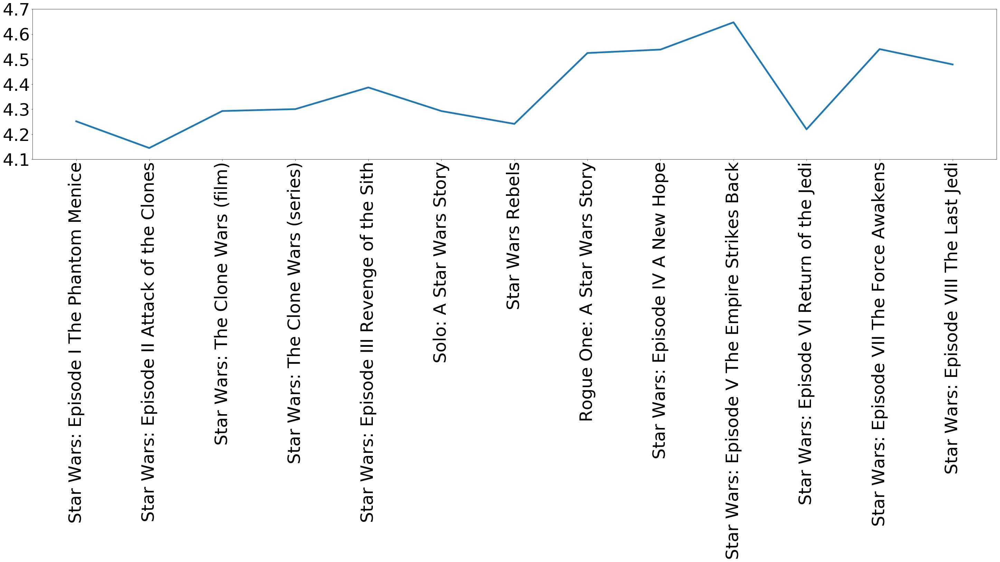

In [20]:
sentiment_by_time = []
media_name = []

sentiment_tcw_tv = []
sentiment_rebels = []

for cat, name in media_in_time_order:
    if cat == "movies":
        sentiment_by_time.append(transcript_tokens[name]["sentiment"])
        media_name.append(name)
    if cat == "series":
        episode_list = []
        sentiment_list = []
        for e in transcript_tokens[name]:
            if e not in ("TFIDF", "all_tokens"):
                episode_list.append(transcript_tokens[name][e]["episode"])
                sentiment_list.append(transcript_tokens[name][e]["sentiment"])
                df_temp = pd.DataFrame(data=dict(episode=episode_list, sentiment=sentiment_list))
                df_temp = df_temp.sort_values(by="episode", ascending=True)
        sentiment_by_time.append(np.mean(df_temp.sentiment.values))
        if "Clone Wars" in name:
            sentiment_tcw_tv = df_temp.sentiment.values
        else:
            sentiment_rebels = df_temp.sentiment.values
        media_name.append(name)

sentiment_json = {"data": {"sentiment": sentiment_by_time, "name": media_name}}
with open("Data/sentiment.json", 'w') as f:
    json.dump(sentiment_json, f)
plt.figure(figsize=(50, 8))
plt.plot(media_name, sentiment_by_time, linewidth=5)
plt.xticks(range(len(media_name)), media_name, fontsize=50, rotation=90)
yticks = [round(x, 1) for x in plt.yticks()[0]]

plt.yticks(yticks, yticks, fontsize=50)
plt.savefig("Data/sentiment_with_time.png", bbox_inches='tight')

# plt.figure(figsize=(50, 8))
# plt.plot(sentiment_tcw_tv, linewidth=5)
# #plt.xticks(range(len(sentiment_tcw_tv)), range(len(sentiment_tcw_tv)), fontsize=50)
# yticks = [round(x, 1) for x in plt.yticks()[0]]
# xticks = [int(x) for x in plt.xticks()[0]]
# plt.xticks(xticks, xticks, fontsize=50)
# plt.yticks(yticks, yticks, fontsize=50)
# plt.xlim([0, len(sentiment_tcw_tv)+1])
# plt.xlabel("Episode number", fontsize=55)
# plt.title("Star Wars: The Clone Wars TV-series", fontsize=55)
# plt.savefig("Data/sentiment_tcw_tv.png", bbox_inches='tight')

# plt.figure(figsize=(50, 8))
# plt.plot(sentiment_rebels, linewidth=5)
# #plt.xticks(range(len(sentiment_tcw_tv)), range(len(sentiment_tcw_tv)), fontsize=50)
# yticks = [round(x, 1) for x in plt.yticks()[0]]
# xticks = [int(x) for x in plt.xticks()[0]]
# plt.xticks(xticks, xticks, fontsize=50)
# plt.yticks(yticks, yticks, fontsize=50)
# plt.xlim([0, len(sentiment_rebels)+1])
# plt.xlabel("Episode number", fontsize=55)
# plt.title("Star Wars Rebels", fontsize=55)
# plt.savefig("Data/sentiment_rebels.png", bbox_inches='tight')
# Do axis manipulation

Looking at the sentiment timeline on the graph above I can think of no reason related to the storyline in the movies that explains the changes in sentiment. Perhaps the movies can't be compared since the scripts are written by different people that have different style of writing. Perhaps this is affecting the sentiment in the scripts in some way.

# 4. Discussion

From the networks built for each movie and TV-series we found out who the most important characters were. To do that we considered node degrees, eigenvector centrality and betweenness centrality. We could see a pattern in who these characters are. They are in most cases the characters that are at the center of the story being told in the films/TV-series. In a few cases they are also characters that have become somewhat of fan favorites and therefore they perhaps have more detailed Wookieepedia articles compared to other extras. The same thing applies to the network that was built from all the movies and TV-series together.

Community detection was performed on the big network for the entire Star Wars universe. At first the affiliations each character had were explored as communities. They can be used as communities, but they are not optimal. In many cases many of the communities have mixed members. The optimal community partition was found and it turned out to have considerably purer communities compared to the affiliations.

From the Wookieepedia pages of each character the sentiment of the character was calculated. By looking at the top 5 and bottom 5 characters based on centiment, i.e. the most happy/positve and unhappy/negative characters we clearly saw that the most positive characters are those that we can call the "good guys" and the most negative characters are those that we can call the "bad guys" or are affiliated with the "bad guys".

For text analysis we looked at the scripts for each of the movies and TV-series. By using TF-IDF and Word Clouds the words the characterize each scripts were visualized. They turned out to include the name of the characters that are at the center of each movie along with some words that describe what happens in the movie. It is harder to describe this for the TV-series since each episode tells a different story and therefore there is no one distinct theme to them. Perhaps the Word Clouds could be improved by looking better at each one of them and determine what generic words should not appear since they give no context to the storyline.

Finally, sentiment analysis was performed on the scripts from the movie/TV-series. The average sentiment for each film could not be explained by thinking about what happens in the films. Perhaps the scripts are influenced to much by who writes them and are therefore not optimal for comparison between each other. Perhaps the sentiment of the characters that are active in each film could be used instead, or the two could perhaps be combined in some way to give a better neutral measure of the sentiment?

# References

[1] Albert-László Barabási. *Network Science*. Published on: **http://networksciencebook.com/**

[2] Wikipedia: Eigenvector centrality. 2018. **https://en.wikipedia.org/wiki/Eigenvector_centrality**

[3] Eigenvector Centrality. **https://www.sci.unich.it/~francesc/teaching/network/eigenvector.html**

[4] Wikipedia: Betweenness centrality. 2018. **https://en.wikipedia.org/wiki/Betweenness_centrality**

[5] Betweenness Centrality. **https://www.sci.unich.it/~francesc/teaching/network/betweeness.html**

[6] Wookieepedia, the Star Wars Wiki. **http://starwars.wikia.com/wiki/Main_Page**

[7] Springfield! Springfield!. **https://www.springfieldspringfield.co.uk/**

[8] WordCloud for Python documentation. 2018. **https://amueller.github.io/word_cloud/**

[9] ForceAtlas2 for Python and NetworkX. 2017. **https://github.com/bhargavchippada/forceatlas2**

[10] NetworkX for Python. 2014-2018. **https://networkx.github.io/documentation/stable/#**

[11] Louvain Community Detection. **https://github.com/taynaud/python-louvain**

[12] Peter Sheridan Dodds , Kameron Decker Harris, Isabel M. Kloumann, Catherine A. Bliss, Christopher M. Danforth. December 7, 2011. *Temporal Patterns of Happiness and Information in a Global Social Network: Hedonometrics and Twitter*. **https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0026752**

[13] Python Regular expressions. **https://docs.python.org/3/library/re.html**

[14] Steven Bird, Ewan Klein, and Edward Loper. 2009. *Natural Language Processing with Python*. **http://www.nltk.org/book_1ed/**

[15] Wikipedia: tf-idf. 2018. **https://en.wikipedia.org/wiki/Tf%E2%80%93idf**